# Fraud Detection in credit-card transactions


## Introduction and Objective

---



---



**BACKGROUND**

Istitute of Elelctrical and Electronics Enngineers-Computational Intelligence society (IEEE-CIS) works across a variety of AI and machine learning areas, including deep neural networks, fuzzy systems, evolutionary computation, and swarm intelligence. They had partnered with the world’s leading payment service company, Vesta Corporation, seeking the best solutions for fraud prevention industry. 

**OBJECTIVE**:

**The task is to  benchmark machine learning models on a challenging large-scale dataset. If successful, the model(s) will improve the efficacy of fraudulent transaction alerts for millions of people around the world, helping hundreds of thousands of businesses reduce their fraud loss and increase their revenue.** 


The data comes from Vesta's real-world e-commerce transactions and contains a wide range of features from device type to product features. You also have the opportunity to create new features to improve your results.

**Acknowledgements**:

Vesta Corporation provided the dataset for this competition. Vesta Corporation is the forerunner in guaranteed e-commerce payment solutions. Founded in 1995, Vesta pioneered the process of fully guaranteed card-not-present (CNP) payment transactions for the telecommunications industry. Since then, Vesta has firmly expanded data science and machine learning capabilities across the globe and solidified its position as the leader in guaranteed ecommerce payments. Today, Vesta guarantees more than $18B in transactions annually.



## Dataset Description


---



---



**Dataset Description**:

The dataset contains 590,540 card transactions, 20,663 of which are fraudulent (3.5%). Each transaction has **431 features** (400 numerical, 31 categorical), along with the relative **timestamp** and a label of whether it was fraudulent or legitimate. For anonymization purposes, the names of the identity features have been masked, along with the names of the extra features engineered by Vesta.

In this project we are supposed to evaluate the probability/anomaly score that an online transaction is fraudulent, as denoted by the binary target is Fraud.

The data is broken into two files 1. **identity** and **transaction**, which are joined by TransactionID. Not all transactions have corresponding identity information.

**Categorical Features - Transaction**
- ProductCD
- card1-card6
- addr1, 
- addr2
- P_emaildomain
- R_emaildomain
- M1 - M9

**Categorical Features - Identity**
- DeviceType
- DeviceInfo
- id_12 - id_38

The TransactionDT feature is a timedelta from a given reference datetime (not an actual timestamp).

**Files**
- **`train_{transaction, identity}.csv`** - the training set
- **`test_{transaction, identity}.csv`** - the test set (you must predict the isFraud value for these observations)

**As we can notice, the data-sets we have been provided with contains 2 files, namely, a. transaction and b. identity for each train and test set.**

  🔑 **URL to download the dataset**: [Kaggle](https://www.kaggle.com/competitions/ieee-fraud-detection/data)

  🔑 **Additional Resources**: [Benchmark models-Papers with code](https://paperswithcode.com/dataset/ieee-cis-fraud-detection-1)

## More Information about the Dataset
**Transaction Table**

- TransactionDT: timedelta from a given reference datetime (not an actual timestamp)
- TransactionAMT: transaction payment amount in USD
- ProductCD: product code, the product for each transaction
- card1 - card6: payment card information, such as card type, card category, issue bank, country, etc.
- addr: address
- dist: distance
- P_ and (R__) emaildomain: purchaser and recipient email domain
- C1-C14: counting, such as how many addresses are found to be associated with the payment card, etc. The actual meaning is masked.
- D1-D15: timedelta, such as days between previous transaction, etc.
- M1-M9: match, such as names on card and address, etc.
- Vxxx: Vesta engineered rich features, including ranking, counting, and other entity relations.

Categorical Features:
- ProductCD
- card1 - card6
- addr1, addr2
- P_emaildomain
- R_emaildomain
- M1 - M9

**Identity Table**

Variables in this table are identity information – network connection information (IP, ISP, Proxy, etc) and digital signature (UA/browser/os/version, etc) associated with transactions.

They're collected by Vesta’s fraud protection system and digital security partners.
(The field names are masked and pairwise dictionary will not be provided for privacy protection and contract agreement)

Categorical Features:
- DeviceType
- DeviceInfo
- id_12 - id_38

## Exploratory Data Analysis on the data-sets - Part I


---



---



**We first conduct Exploratory data analysis (EDA) on the transaction and identity files (within the train data) seaparatly.** 

## Load the Data-files


---



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
"""The data set have been provided as zip files and we have written a function to unzip the data here
to save space in drive in the helper_functions file. So we load the helper_functions file first and import the
required functions.It requires the file path and the destination name too (not underlined part of the code."""

# Importing the helper_functions file
!cp /content/drive/MyDrive/PCMALAI_UCBerkeley_Capstone/Notebooks/helper_functions.py helper_functions.py

# Import the required function(s) from the helper_functions file
from helper_functions import unzip_data

# Unzip data
unzip_data("/content/drive/MyDrive/PCMALAI_UCBerkeley_Capstone/data/ieee-fraud-detection.zip")
"""The above function would give 4 files: (train_transaction.csv and train_identity.csv) for train set and 
                                          (test_identity.csv and test_transaction.csv) for test set."""



'The above function would give 4 files: (train_transaction.csv and train_identity.csv) for train set and \n                                          (test_identity.csv and test_transaction.csv) for test set.'

In [3]:
# Reading/Loading the data files (transaction and identity)
import pandas as pd
import numpy as np

train_transaction = pd.read_csv("train_transaction.csv")
# train_identity = pd.read_csv("test_transaction.csv") 

## EDA of **`train_transaction`** file


---


### **BASIC EDA**


In [4]:
# printing the train_transaction df
train_transaction.head(5)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
# Information on the columns of train_transaction df
train_transaction.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 590540 entries, 0 to 590539
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 1.7+ GB


In [6]:
# data type of the specific columns
print(train_transaction.dtypes)

TransactionID       int64
isFraud             int64
TransactionDT       int64
TransactionAmt    float64
ProductCD          object
                   ...   
V335              float64
V336              float64
V337              float64
V338              float64
V339              float64
Length: 394, dtype: object


In [7]:
# Basic statistical despcription of train_transaction df
train_transaction.describe()


,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,3.282270e+06,0.034990,7.372311e+06,135.027176,9898.734658,362.555488,153.194925,199.278897,290.733794,86.800630,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,1.704744e+05,0.183755,4.617224e+06,239.162522,4901.170153,157.793246,11.336444,41.244453,101.741072,2.690623,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,2.987000e+06,0.000000,8.640000e+04,0.251000,1000.000000,100.000000,100.000000,100.000000,100.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,3.134635e+06,0.000000,3.027058e+06,43.321000,6019.000000,214.000000,150.000000,166.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,3.282270e+06,0.000000,7.306528e+06,68.769000,9678.000000,361.000000,150.000000,226.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,3.429904e+06,0.000000,1.124662e+07,125.000000,14184.000000,512.000000,150.000000,226.000000,330.000000,87.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,3.577539e+06,1.000000,1.581113e+07,31937.391000,18396.000000,600.000000,231.000000,237.000000,540.000000,102.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [8]:
# Percentage of Null values of each column the data frame
null_columns = train_transaction.isna().sum()
#print(f"The dtype of null_columns is: '{null_columns.dtype()}'")
print(f"The columns with zero null values is: /n '{null_columns[null_columns==0]}'")
print(f"The number of columns with zero null values is: '{len(null_columns[null_columns==0])}' ")
print(f"The percentage of null values in the following column is : '{null_columns[null_columns>0]/train_transaction.shape[0]}'")
print(f"The number of columns with non-zero null values is :'{len(null_columns[null_columns>0])}' ")
print(max(null_columns[null_columns>0]/train_transaction.shape[0]))

The columns with zero null values is: /n 'TransactionID     0
isFraud           0
TransactionDT     0
TransactionAmt    0
ProductCD         0
card1             0
C1                0
C2                0
C3                0
C4                0
C5                0
C6                0
C7                0
C8                0
C9                0
C10               0
C11               0
C12               0
C13               0
C14               0
dtype: int64'
The number of columns with zero null values is: '20' 
The percentage of null values in the following column is : 'card2    0.015127
card3    0.002650
card4    0.002670
card5    0.007212
card6    0.002660
           ...   
V335     0.860550
V336     0.860550
V337     0.860550
V338     0.860550
V339     0.860550
Length: 374, dtype: float64'
The number of columns with non-zero null values is :'374' 
0.9362837403054831


#### **Summary of Basic Eda**


The `train_transaction` dataframe contains 590540 **(~590K)** entries/observations/rows and **394** columns with the **target** column **`isFraud`** having **no null** values. The target feature is represented as a numeric column with '0' representing a non-fraud transaction and '1' represeting a fraud transaction. 

The target column also contains only 3.5% values that represent fradulent transaction of the total transactions. In other words we have only **~20,610 observations/rows** that portray the features that describe the **fradulent** transactions. The dataset that we have been presented with is highly imbalanced as expected due to the inherent nature of the low number of fraud transaction happening in real world compared to legally correct transation(s). **This implies we have to come up with ways to address the imbalance present in this dataset.** 

This dataset has **376 columns** with **float64**, **4 columns** with **int64**,and **14 columns** with object data type. Among these columns, there are only 20 columns with no-null values and 374 columns with null values ranging from 2% to about 94%. Further this dataset also contains features obtained after performing **data/feature enrichment** (V1-V339) and hence it is difficult to find further details about many columns/features. 

Hence, we proceed to conduct visual data analysis of this dataset to find any patterns/insights. 

It is to be noted that the dataset contains many obfuscated features whose real world meaning is unobtainable and also the data is presented in groups of features (whose meaning is described in 'More Information about the Dataset heading) as described below:
- TransactionID, isFraud, TransactionDT, TransactionAmt, ProductCD,
- card1, card2, card3, card4, card5, card6,
- addr1, addr2, dist1, dist2, P_emaildomain, R_emaildomain,
- C1, C2, C3, C4, C5, C6, C7, C8, C9, C10, C11, C12, C13, C14,
- D1, D2, D3, D4, D5, D6, D7, D8, D9, D10, D11, D12, D13, D14, D15,
- M1, M2, M3, M4, M5, M6, M7, M8, M9,
- V1, V2, V3, V4, V5, V6, V7, V8, V9, V10, V11, V12, V13, V14, V15, V16, V17, V18, V19, V20, V21, V22, V23, V24, V25, V26, V27, V28, V29, V30, V31, V32, V33, V34, V35, V36, V37, V38, V39, V40, V41, V42, V43, V44, V45, V46, V47, V48, V49, V50, V51, V52, V53, V54, V55, V56, V57, V58, V59, V60, V61, V62, V63, V64, V65, V66, V67, V68, V69, V70, V71, V72, V73, V74, V75, V76, V77, V78, V79, V80, V81, V82, V83, V84, V85, V86, V87, V88, V89, V90, V91, V92, V93, V94, V95 .... V337, V338, V339.











### VISUAL EDA

In [9]:
# importing the libraries
import matplotlib.pyplot as plt
import seaborn as sns


/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:168: MatplotlibDeprecationWarning: Support for uppercase single-letter colors is deprecated since Matplotlib 3.1 and will be removed in 3.3; please use lowercase instead.
  kws.setdefault("facecolor", to_rgba(color, alpha))


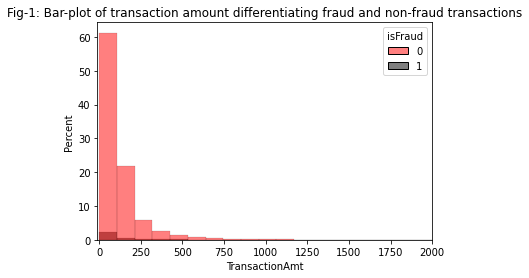

In [10]:
# Bar plot of the transaction amount to inspect the distribution of the feature
fig, ax = plt.subplots()
sns.histplot(data=train_transaction,x='TransactionAmt',hue='isFraud',bins=300,palette=["R", "K"],stat='percent')
ax.set_xlim(-10,2000)
plt.title("Fig-1: Bar-plot of transaction amount differentiating fraud and non-fraud transactions")
plt.show()

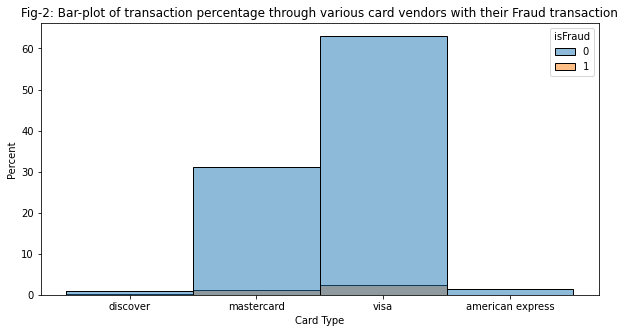

In [11]:
# Barplot of transactions through various card vendors (card4) differentiating fraudulent and true transactions
plt.figure(figsize=(10,5))
sns.histplot(data=train_transaction,x='card4',hue='isFraud',stat='percent')
plt.title("Fig-2: Bar-plot of transaction percentage through various card vendors with their Fraud transaction")
plt.xlabel('Card Type')
plt.show()

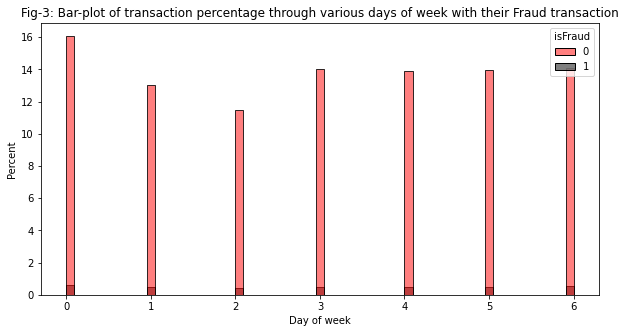

In [12]:
# preprocess the datetime column
# get it down to day of week, hour
# hue by day of week
# countplot of 'isFraud'

train_transaction['Transaction_dow'] = np.floor((train_transaction['TransactionDT'] / (3600 * 24) - 1) % 7)
train_transaction['Transaction_hour'] = np.floor(train_transaction['TransactionDT'] / 3600) % 24

plt.figure(figsize=(10,5))
sns.histplot(data=train_transaction,x='Transaction_dow',hue='isFraud',stat='percent',palette=["R", "K"])
plt.title("Fig-3: Bar-plot of transaction percentage through various days of week with their Fraud transaction")
plt.xlabel('Day of week')
plt.show()

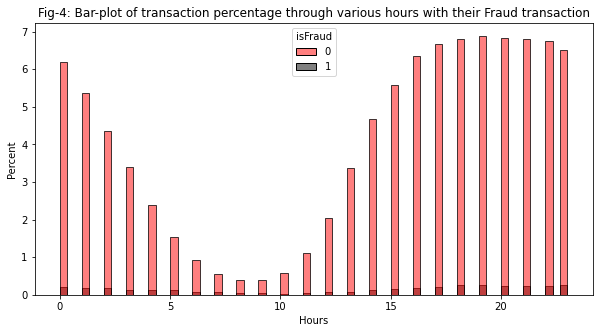

In [13]:
plt.figure(figsize=(10,5))
sns.histplot(data=train_transaction,x='Transaction_hour',hue='isFraud',stat='percent',palette=["R", "K"])
plt.title("Fig-4: Bar-plot of transaction percentage through various hours with their Fraud transaction")
plt.xlabel('Hours')
plt.show()

Text(0.5, 1.0, 'Fig-5: Relative counts of the real and fraud transactions in the data')

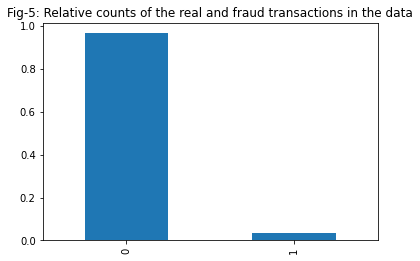

In [14]:
# count plots of the two classes
train_transaction['isFraud'].value_counts(normalize=True).plot(kind='bar')
plt.title("Fig-5: Relative counts of the real and fraud transactions in the data")


In [10]:
# Box-plot of numerical features

num_column_lst = []
for icol in train_transaction.columns:
  if train_transaction[icol].dtypes in ['float64', 'int64']:
    num_column_lst.append(icol)
print(f"The columns that have numerical features are: '{num_column_lst}'")

""" 
The column V1-V339 are data enriched dfeatures provided to us and we since we do not know what they represent
we won't be able to conduct feature engineering for outlier removal etc. Hence we need only the rest 
42 columns which we can select by printing and selcting the respective columns in list.

TransactionID is just an identification and so a box plot of the same does not make sense. So we are not considering it
for the box plots.
"""

num_cols_lst = ['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']
fig, axs = plt.subplots(nrows = 8, ncols=5, figsize = (150,100))
for name,ax in zip(num_cols_lst,axs.flatten()):
  sns.boxplot(data=train_transaction,x=name,ax=ax)
  # plt.show()
fig.tight_layout()
fig.suptitle('Figure-6: Box plot of non-principal components numerical variables',y=1.1,fontsize=16)


The columns that have numerical features are: '['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V82', 'V83', 'V84', 'V85', 'V86', 'V87', 'V88', 'V89', 'V90', 'V91', 'V92

Text(0.5, 1.1, 'Figure-6: Box plot of non-principal components numerical variables')

['ProductCD', 'card4', 'card6', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']


Text(0.5, 1.02, 'Figure-7: Bar-plot of Categorical variables')

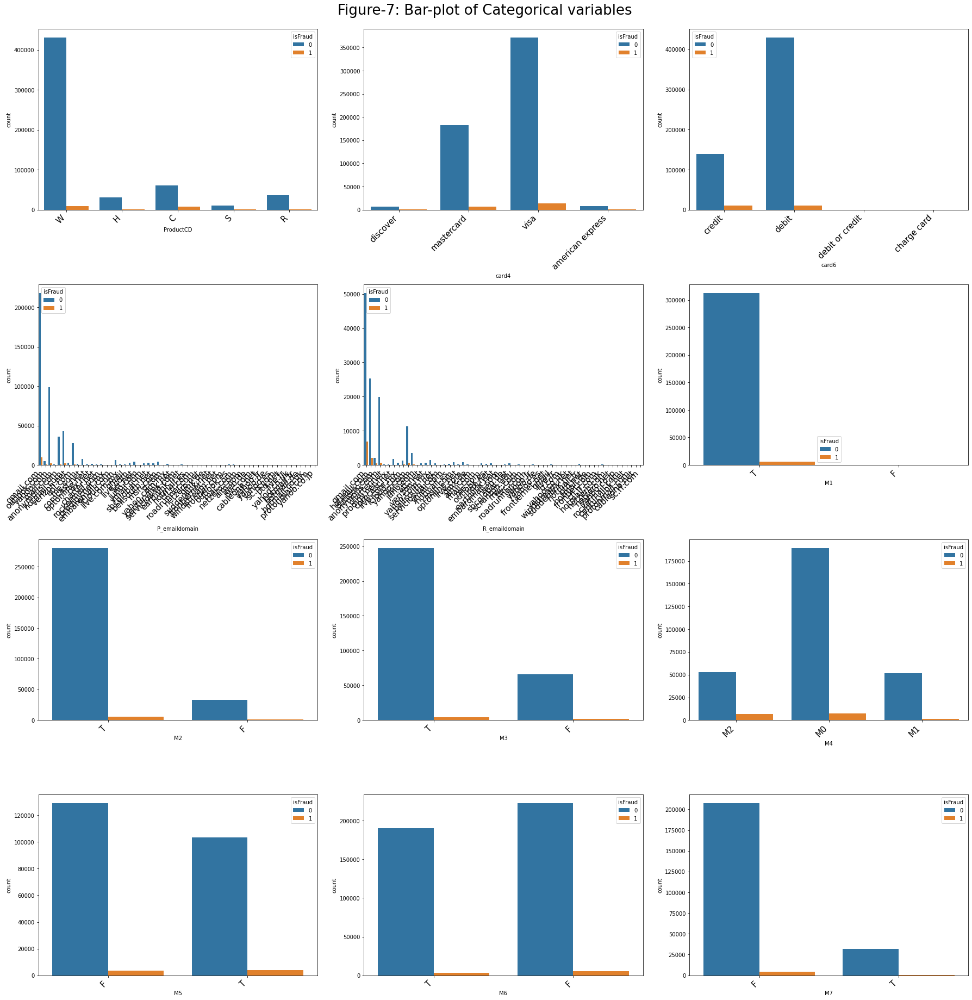

In [11]:
# Bar-Plots of the 14 categorical features(non-enriched features) to examine the distribution of the various categories in a feature
cat_column_lst = []
for icol in train_transaction.columns:
  if train_transaction[icol].dtypes in ['object']:
    cat_column_lst.append(icol)
print(cat_column_lst)

fig, axs = plt.subplots(nrows = 4, ncols=3, figsize = (25,25))
for name,ax in zip(cat_column_lst,axs.flatten()):
  sns.countplot(data=train_transaction,x=name,ax=ax,hue='isFraud')
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=15)
  
fig.tight_layout()
fig.suptitle('Figure-7: Bar-plot of Categorical variables',y=1.02,fontsize=26)

In [12]:
num_cols_lst = ['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']

Text(0.5, 1.02, 'Figure-8: Distribution plot of numerical variables')

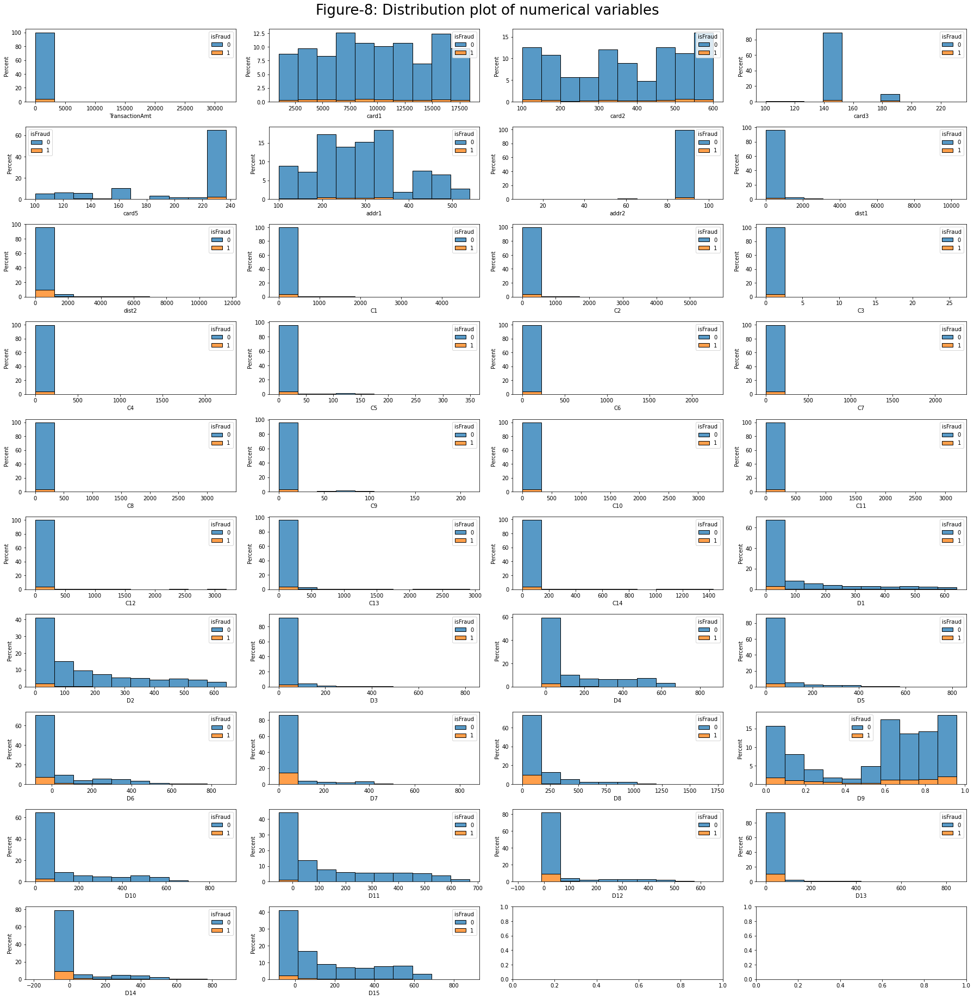

In [13]:
# Bar-Plots of the numerical features(non-enriched) to examine the distribution of the feature

fig, axs = plt.subplots(nrows = 10, ncols=4, figsize = (25,25))
for name,ax in zip(num_cols_lst,axs.flatten()):
  sns.histplot(data=train_transaction,x=name,ax=ax,hue='isFraud',multiple='stack',stat='percent',bins=10)
  #ax.set_xticklabels(ax.get_xticklabels(minor=True,which='minor'),rotation=0,fontsize=15)
  
fig.tight_layout()
fig.suptitle('Figure-8: Distribution plot of numerical variables',y=1.02,fontsize=26)


#### **Summary of Visual EDA**

The dataset has transactions that mainly ranges from 0 to 1200 (currency units). The fradulent transactions especially are limited between few to less than 1000 (currency units). Also we have observations from major credit-card providers, Visa, Mastercard, Discover and American express transaction only where Visa card transaction reppresent about 60% of the whole training dataset followed by Mastercard representing about the rest 30% of the observations. The fraudulent transactions also follow a similar tren where Visa represents the highest of them folllowed by Mastercard. However, the proportion of fraud transaction to real transaction happens to be lowest for th Visa card providers. The fraud transactions seems to be more promimnet during the early hours and from later afternoon hours of the day with ~6 to 12 hrs portraying a relatively lull period for such transaction in this dataset. Furthermore, no such trend was foung for fraudulent transaction(s) frequency within the different days of the week. 

We constructed box plots of the numerical features and found that there were significant outliers in almost all the numerical features exceting a few (card1, card2, card5, D2, D9,and D11). Hence we decided that we would not be removing the outlier. Also given the size, and emormity of the data, low representation of one class along with huge number of obfuscated features prevented us from coming up with a effective and eeficient way to remove outliers. However it is worth to be noted that the transaction amount had significant outliers that extended beyond the 90th percentile of about 1200 (currency units) uptill ~5000 (currency units). 

The categorical column were analysed through visualizations using the bar plots that were hued based on the target classes. The numerical columns were also visualised with bar plots/histograms for visualizing the distributions of the numerical features. We found that no feature was conspicuous enought to be able to porvide a insight on the fraud transactions. ALso, the obfuscated nature of most of the features made it difficult to draw any specif conclusion from box-plot, bar-plot and histograms combined too. The fraud transactions are almost always present in all the unique labels of the categorical features and also most of the bins of the numerical features whi indicates the complexity of the problem. The presence or absence of outliers in a particular feature also didnot influence the spread of fraud transactions in that feature (eg. D9, D11 etc) where the fraudulent transactions are almost always present in all the bins like featrues with significant outliers. Also the fraudulent transactions did not protray any noticeable distribution patterns from which we could extract any potential insights for further analysis. 

Hence we could conclude that the Basic and Visual EDA of the transaction dataset indicates a complex data and that the objective to build a classification model to be challenging task that requires a step-wise approach to EDA followed by sophisticated models to suffcienyly represent the data to predict the fraudulent transaction with a high accuracy. 

### BASIC EDA OF FRAUDULENT TRANSACTION DATA

In [14]:
# Creation of DF with 'isfraud==true' data 
isfraudt_df = train_transaction.loc[train_transaction['isFraud']==1]
isfraudt_df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
203,2987203,1,89760,445.000,W,18268,583.0,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
240,2987240,1,90193,37.098,C,13413,103.0,185.0,visa,137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
243,2987243,1,90246,37.098,C,13413,103.0,185.0,visa,137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
245,2987245,1,90295,37.098,C,13413,103.0,185.0,visa,137.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
288,2987288,1,90986,155.521,C,16578,545.0,185.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
# Information of the isfraud_df
isfraudt_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 20663 entries, 203 to 590526
Columns: 394 entries, TransactionID to V339
dtypes: float64(376), int64(4), object(14)
memory usage: 62.3+ MB


In [16]:
# Basic statistical description of the isfraud_df
isfraudt_df.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,2.066300e+04,20663.0,2.066300e+04,20663.000000,20663.000000,20240.000000,20624.000000,20453.000000,12922.000000,12922.000000,...,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000,3686.000000
mean,3.294952e+06,1.0,7.690033e+06,149.244779,9547.654164,365.370850,162.368648,191.994328,294.317134,86.286024,...,0.313619,90.384699,164.859468,127.633749,9.299240,49.394466,25.483993,37.742268,53.242268,45.496473
std,1.620403e+05,0.0,4.416551e+06,232.212163,4762.051380,159.623511,17.495775,45.779886,103.584955,4.936238,...,0.960475,227.643019,436.287131,339.856944,51.502023,201.848261,117.938993,142.505208,190.250383,175.966280
min,2.987203e+06,1.0,8.976000e+04,0.292000,1015.000000,100.000000,100.000000,100.000000,110.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.167366e+06,1.0,3.965858e+06,35.044000,5732.500000,204.000000,150.000000,138.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.291934e+06,1.0,7.575230e+06,75.000000,9633.000000,375.000000,150.000000,224.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,3.428646e+06,1.0,1.121743e+07,161.000000,13623.000000,514.000000,185.000000,226.000000,330.000000,87.000000,...,0.000000,75.000000,150.000000,100.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,3.577526e+06,1.0,1.581088e+07,5191.000000,18375.000000,600.000000,231.000000,237.000000,536.000000,96.000000,...,13.000000,2600.000000,4700.000000,4285.000000,635.000000,2430.000000,1605.000000,2200.000000,2400.000000,2400.000000


In [17]:
## Percentage of Null values of each column the of the isfraud_df

isfraudt_null_columns = isfraudt_df.isna().sum()

print(f"The columns with zero null values is:  '{isfraudt_null_columns[isfraudt_null_columns==0]}'")
print(f"The number of columns with zero null values is: '{len(isfraudt_null_columns[isfraudt_null_columns==0])}' ")
print(f"The percentage of null values in the following column is : '{isfraudt_null_columns[isfraudt_null_columns>0]/train_transaction.shape[0]}'")
print(f"The number of columns with non-zero null values is :'{len(isfraudt_null_columns[isfraudt_null_columns>0])}' ")
print(max(isfraudt_null_columns[isfraudt_null_columns>0]/train_transaction.shape[0]))


The columns with zero null values is:  'TransactionID     0
isFraud           0
TransactionDT     0
TransactionAmt    0
ProductCD         0
card1             0
C1                0
C2                0
C3                0
C4                0
C5                0
C6                0
C7                0
C8                0
C9                0
C10               0
C11               0
C12               0
C13               0
C14               0
dtype: int64'
The number of columns with zero null values is: '20' 
The percentage of null values in the following column is : 'card2    0.000716
card3    0.000066
card4    0.000069
card5    0.000356
card6    0.000066
           ...   
V335     0.028748
V336     0.028748
V337     0.028748
V338     0.028748
V339     0.028748
Length: 374, dtype: float64'
The number of columns with non-zero null values is :'374' 
0.02880922545466861


#### **Summary of Basic EDA of Fradulent Transactions**

Upon the initial EDA of the data that contains only the farud transaction we find that the although the number of features that contain/not contain null values remains approximately the same, the percentage of null value sin those columns is significantly less (nealry 96% in total df to just ~3% for fraud data) in data that contains only fraud transactions. 

Although it could be argued that number of onbservations itself is considerabley less for the fraud transaction data and hence a reduction in number of null values could be expected, computing the percentage of the null values in both the complete dataset and the subdataset cossiting of only the fraud transactions has provided the insight that we have more data available for features for the fraudulent transactions. 


### VISUAL EDA OF FRADULENT TRANSACTIONS

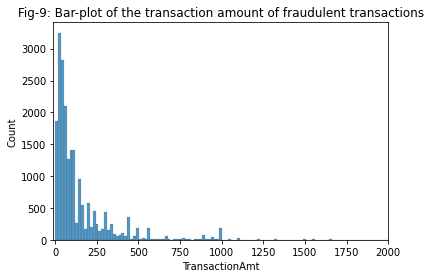

In [23]:
# Bar plot of the transaction amount to inspect the distribution of the feature
fig, ax = plt.subplots()
sns.histplot(data=isfraudt_df,x='TransactionAmt',bins=300)
ax.set_xlim(-10,2000)
plt.title("Fig-9: Bar-plot of the transaction amount of fraudulent transactions")
plt.show()

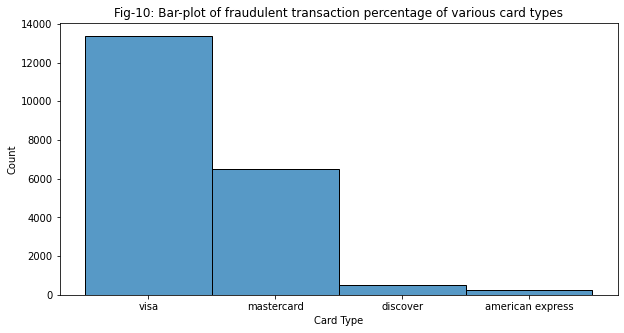

In [24]:
# Barplot of fradulent transactions through various card vendors (card4)
plt.figure(figsize=(10,5))
sns.histplot(data=isfraudt_df,x='card4')
plt.title("Fig-10: Bar-plot of fraudulent transaction percentage of various card types")
plt.xlabel('Card Type')
plt.show()

In [25]:
# Box-plot of 38 non-enriched numerical features of the fradulent transactions

num_cols_lst = ['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']
print(num_cols_lst)

fig, axs = plt.subplots(nrows = 8, ncols=5, figsize = (150,100))
for name,ax in zip(num_cols_lst,axs.flatten()):
  sns.boxplot(data=isfraudt_df,x=name,ax=ax)
  # plt.show()
fig.tight_layout()
fig.suptitle('Fig-11: Box plot of selected numerical variables (non-enriched)of Fradulent transaction data',y=1.1,fontsize=16)

['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']


Text(0.5, 1.1, 'Fig-11: Box plot of selected numerical variables (non-enriched)of Fradulent transaction data')

['ProductCD', 'card4', 'card6', 'P_emaildomain', 'R_emaildomain', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9']


Text(0.5, 1.02, 'Fig-12: Bar-plot of Categorical variables of fraudenlent transaction data')

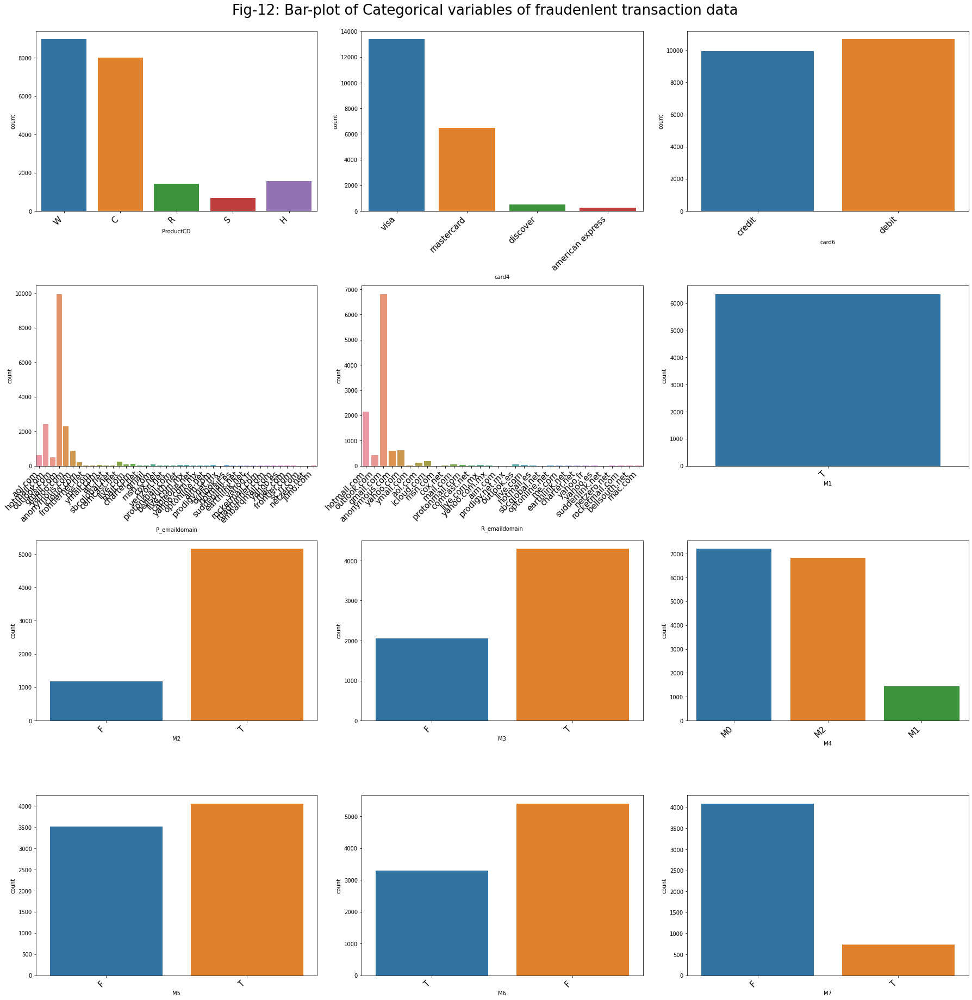

In [26]:
# Bar-Plots of the 14 categorical features(non-enriched features) to examine the distribution of the various categories in a feature

print(cat_column_lst)

fig, axs = plt.subplots(nrows = 4, ncols=3, figsize = (25,25))
for name,ax in zip(cat_column_lst,axs.flatten()):
  sns.countplot(data=isfraudt_df, x=name, ax=ax)
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right',fontsize=15)
  
fig.tight_layout()
fig.suptitle('Fig-12: Bar-plot of Categorical variables of fraudenlent transaction data',y=1.02,fontsize=26)

['TransactionAmt', 'card1', 'card2', 'card3', 'card5', 'addr1', 'addr2', 'dist1', 'dist2', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15']


Text(0.5, 1.02, 'Figure-13: Distribution plot of numerical variables of the fradulent transaction data')

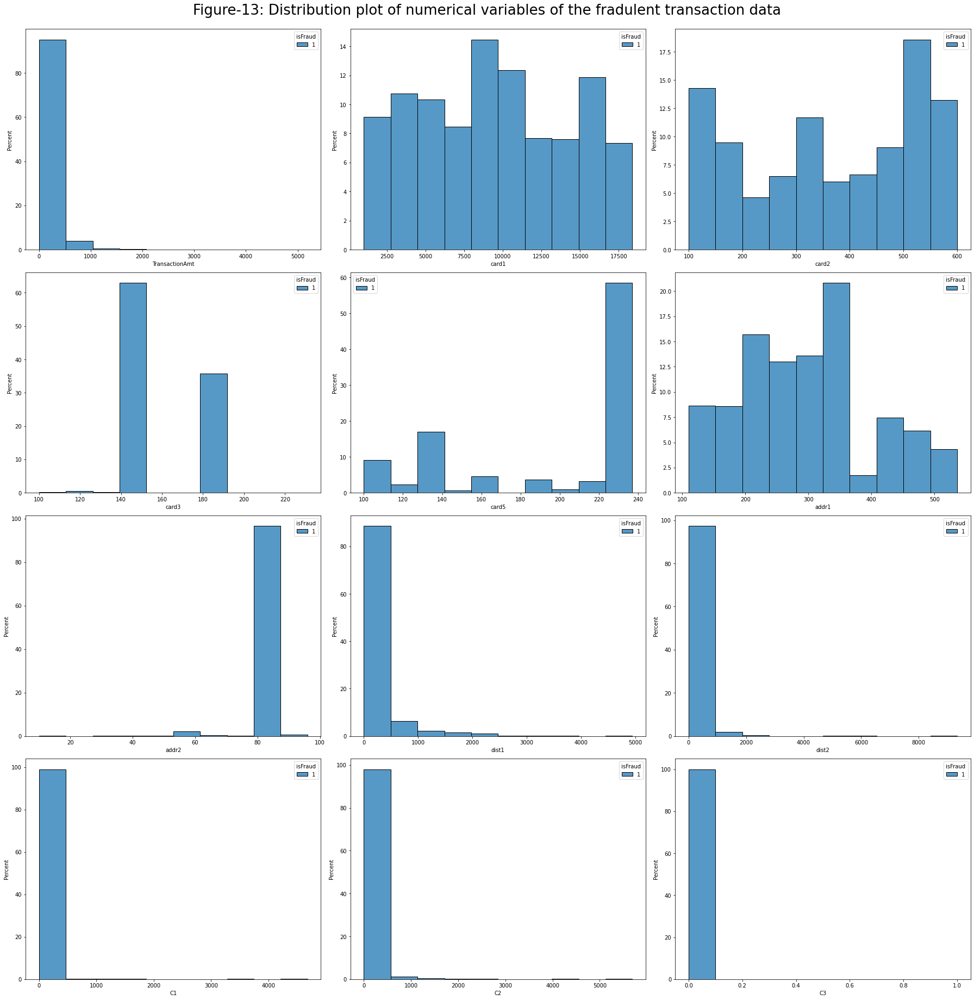

In [27]:
# Bar-Plots of the 42 numerical features(non-enriched) to examine the distribution of the feature

# print(num_column_lst)
print(num_cols_lst)

fig, axs = plt.subplots(nrows = 4, ncols=3, figsize = (25,25))
for name,ax in zip(num_cols_lst,axs.flatten()):
  sns.histplot(data=isfraudt_df,x=name,ax=ax,hue='isFraud',multiple='stack',stat='percent',bins=10)
  #ax.set_xticklabels(ax.get_xticklabels(minor=True,which='minor'),rotation=0,fontsize=15)
  
fig.tight_layout()
fig.suptitle('Figure-13: Distribution plot of numerical variables of the fradulent transaction data',y=1.02,fontsize=26)




#### **Summary of Visual EDA of Fraudulent Transactions**
The box-plot for numerical features, bar-plot for categorical features, and the histogram for numerical features show the details with more granularity of the fraud transaction data that we had already visualized as hued visulations int he complete dataset.

However separate visual analysis of the fraudulent data alone revelas that there are much more numerical features with less or no outliers in this transaction dataset. However interpretable features like transaction amount contain outliers that are similar to that of the whole dataset. Also on close observation we find that the pattern of outliers inmany features are pretty similar to the oulier pattern of the complete dataset, further empahsizing the decision not to remove outliers as it might impact our analysis and reduce the number of fraud transaction observations too. 

This sort of analysis where we have separated one class alone might be helpful for this data as we try to understand other similar features like V-group and other group features. This is because we might be able to find if such huge group features provide any conspicous information from the fraud data alone. based on that we can eliminate/retain or do other feature engineering of such columns. 

One such feature is V-Columns that are 400 in number and hence subsetting and categorizations might help us to break down the task of analysis and further operations in these fetaures. 

### EDA of V1 - V339

In [18]:
# creating sub dataframe of the v-columns

train_transaction_v = train_transaction.iloc[:, 54:395]
train_transaction_v.head()


,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,F,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


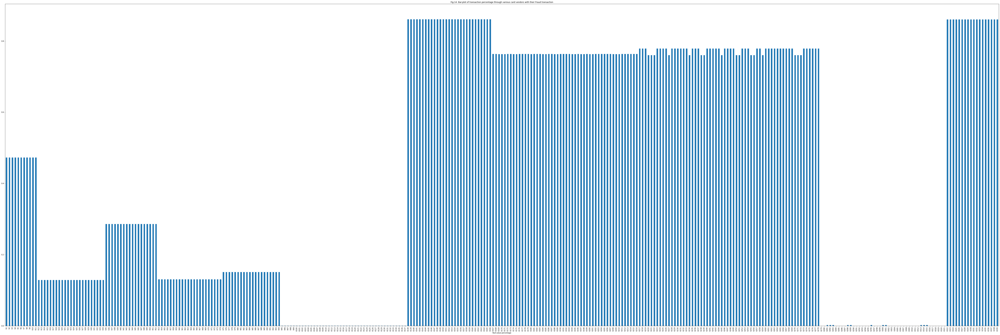

In [19]:
# Bar chart of the V-columns based on the null values
null_columns_prcnt = train_transaction.isna().sum()/train_transaction.shape[0]
colsToPlot = ['V' + str(i) for i in range(1,340)]
plt.figure(figsize=(105,35))
null_columns_prcnt[colsToPlot].plot(kind='bar')
plt.title("Fig-14: Bar-plot of transaction percentage through various card vendors with their Fraud transaction")
plt.xlabel('Null-value percentage')
plt.show()

Text(0.5, 1.1, 'Fig-15: Bar plot of the feature engineered columns separated by groups')

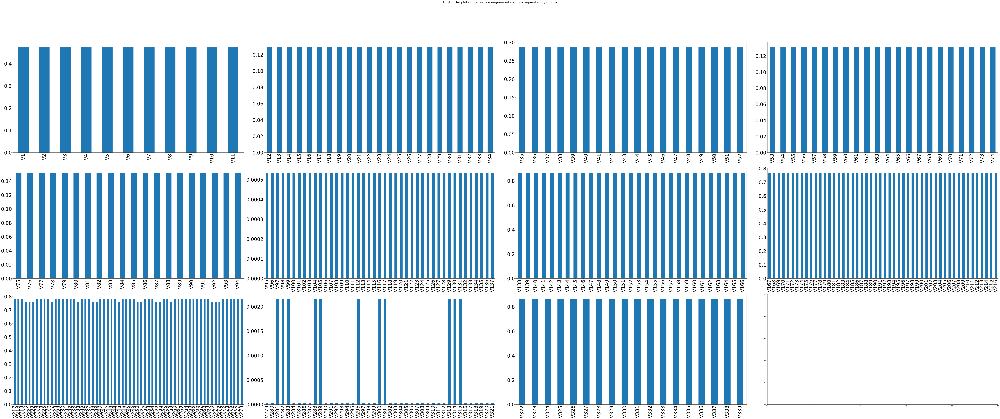

In [20]:
# Creating a dictionary of the groups of V-columns to create subplots of the groups to visualize null values
# Grouping the V-columns based on their percentage of null values

v_group_dict = {'grp1':['V' + str(i) for i in range(1,12)],
                'grp2':['V' + str(i) for i in range(12,35)],
                'grp3':['V' + str(i) for i in range(35,53)],
                'grp4':['V' + str(i) for i in range(53,75)],
                'grp5':['V' + str(i) for i in range(75,95)],
                'grp6':['V' + str(i) for i in range(95,138)],
                'grp7':['V' + str(i) for i in range(138,167)],
                'grp8':['V' + str(i) for i in range(167,217)],
                'grp9':['V' + str(i) for i in range(217,279)],
                'grp10':['V' + str(i) for i in range(279,322)],
                'grp11':['V' + str(i) for i in range(322,340)]}

fig, axs = plt.subplots(nrows = 3, ncols=4, figsize = (105,40))
for name,ax in zip(v_group_dict.keys(),axs.flatten()):
  null_columns_prcnt[v_group_dict[name]].plot(ax=ax,kind='bar')
  ax.tick_params(axis='both', which='major', labelsize=37)

fig.tight_layout()
fig.suptitle('Fig-15: Bar plot of the feature engineered columns separated by groups',y=1.1,fontsize=24)

In [31]:
# correlation each v-columns within the group


In [21]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(corrMatrix, corrThresh):
    au_corr = corrMatrix.abs().unstack()
    labels_to_drop = get_redundant_pairs(corrMatrix)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[au_corr>corrThresh]

def plotCorrMatrixAndGetColsToDrop(df,figsize,threshold,columnsToCorr):
  plt.figure(figsize=figsize)
  grp_correlationMatrix = df[columnsToCorr].corr()
  sns.heatmap(grp_correlationMatrix, cmap='RdBu_r', annot=True, center=0.0)

  #compute the columns to drop from a given list of columns
  high_corr_pairs = get_top_abs_correlations(grp_correlationMatrix, threshold)

  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))
  to_drop = [column for column in upper.columns if any(upper[column] > threshold)]
  
  return high_corr_pairs,grp_correlationMatrix,to_drop

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


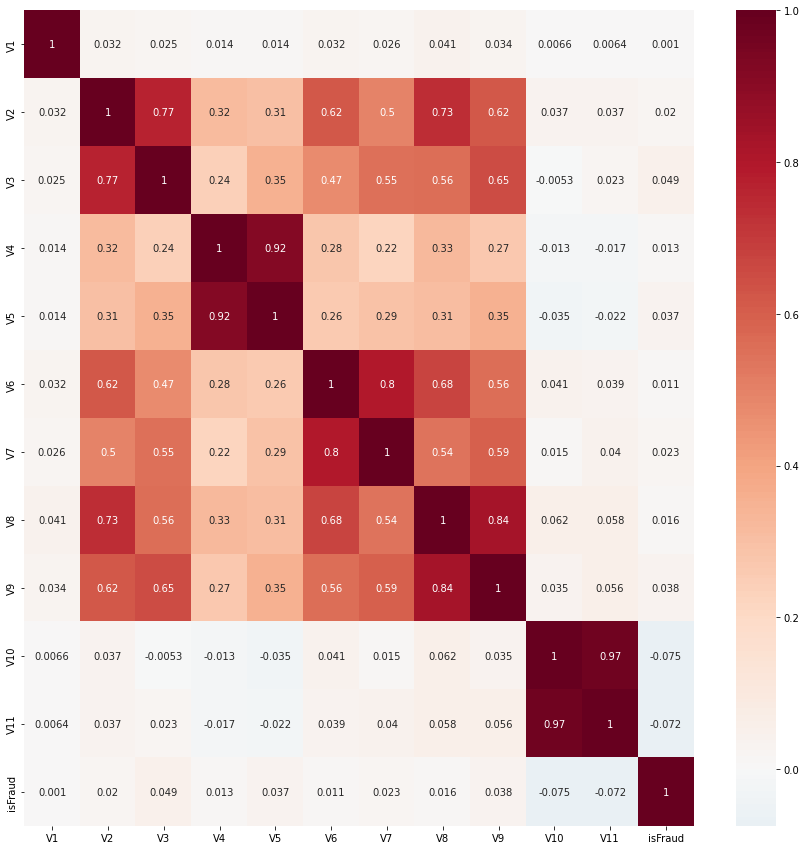

In [22]:
# Correlation of grp-1 with the target variable and within V columns
corrThresh = 0.65
grp1_high_corr_pairs,grp1_correlationMatrix,grp1_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(15,15),corrThresh,v_group_dict['grp1']+['isFraud'])

In [23]:
# extract the results from grp1
retain_cols = list(set(v_group_dict['grp1']) - set(grp1_todrop))
v_grp1_dict_results = {'Columns':v_group_dict['grp1'],
               'num columns':len(v_group_dict['grp1']),
               'Dropping Columns':grp1_todrop,
               'Num Columns Dropped':len(grp1_todrop),
               'Retain Columns':retain_cols,
               'Num Columns Retained': len(retain_cols)}
v_grp1_dict_results

{'Columns': ['V1',
  'V2',
  'V3',
  'V4',
  'V5',
  'V6',
  'V7',
  'V8',
  'V9',
  'V10',
  'V11'],
 'num columns': 11,
 'Dropping Columns': ['V3', 'V5', 'V7', 'V8', 'V9', 'V11'],
 'Num Columns Dropped': 6,
 'Retain Columns': ['V1', 'V10', 'V2', 'V6', 'V4'],
 'Num Columns Retained': 5}

1. Drop the required columns
2. Subset of the V group 1 columns to keep
3. Columns to drop from group 1 - V11,V5,V8,V6,V3

In [35]:
grp1_todrop

['V3', 'V5', 'V7', 'V8', 'V9', 'V11']

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


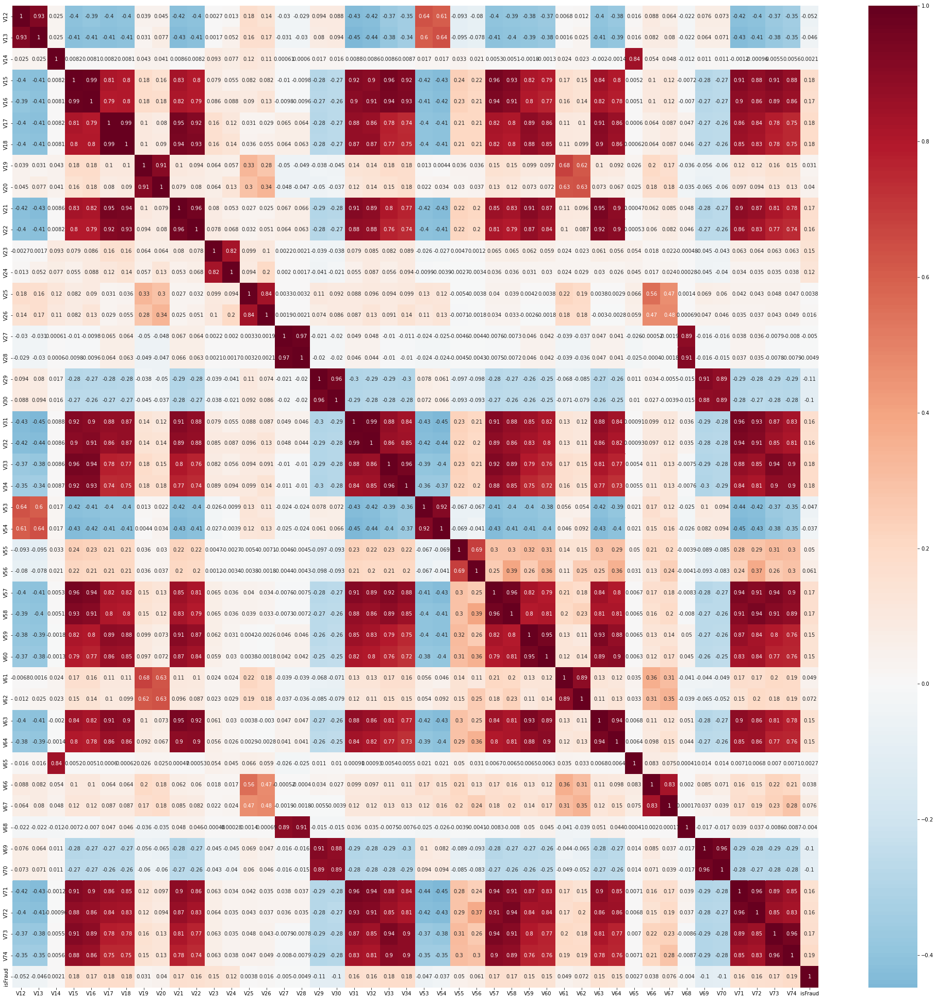

In [24]:
# correlation of group 2 and group 4 v-columns within the group
# plt.figure(figsize=(35,35))
# grp2_correlationMatrix=train_transaction[v_group_dict['grp2']+v_group_dict['grp4']].corr()
grp2n4_high_corr_pairs, grp2n4_correlationMatrix, grp2n4_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35),corrThresh,v_group_dict['grp2']+v_group_dict['grp4']+['isFraud'])

In [37]:
pd.options.display.max_rows = 4000

In [25]:
# extract the results from grp2 and grp4

vgrp2n4_retain_cols = list(set(v_group_dict['grp2']+v_group_dict['grp4']) - set(grp2n4_todrop))
v_grp2n4_dict_results = {'Columns':(v_group_dict['grp2']+v_group_dict['grp4']),
               'num columns':len(v_group_dict['grp2']+v_group_dict['grp4']),
               'Dropping Columns':grp2n4_todrop,
               'Num Columns Dropped':len(grp2n4_todrop),
               'Retain Columns':vgrp2n4_retain_cols,
               'Num Columns Retained': len(vgrp2n4_retain_cols)}
v_grp2n4_dict_results


{'Columns': ['V12',
  'V13',
  'V14',
  'V15',
  'V16',
  'V17',
  'V18',
  'V19',
  'V20',
  'V21',
  'V22',
  'V23',
  'V24',
  'V25',
  'V26',
  'V27',
  'V28',
  'V29',
  'V30',
  'V31',
  'V32',
  'V33',
  'V34',
  'V53',
  'V54',
  'V55',
  'V56',
  'V57',
  'V58',
  'V59',
  'V60',
  'V61',
  'V62',
  'V63',
  'V64',
  'V65',
  'V66',
  'V67',
  'V68',
  'V69',
  'V70',
  'V71',
  'V72',
  'V73',
  'V74'],
 'num columns': 45,
 'Dropping Columns': ['V13',
  'V16',
  'V17',
  'V18',
  'V20',
  'V21',
  'V22',
  'V24',
  'V26',
  'V28',
  'V30',
  'V31',
  'V32',
  'V33',
  'V34',
  'V54',
  'V56',
  'V57',
  'V58',
  'V59',
  'V60',
  'V61',
  'V62',
  'V63',
  'V64',
  'V65',
  'V67',
  'V68',
  'V69',
  'V70',
  'V71',
  'V72',
  'V73',
  'V74'],
 'Num Columns Dropped': 34,
 'Retain Columns': ['V27',
  'V15',
  'V53',
  'V19',
  'V66',
  'V14',
  'V55',
  'V23',
  'V25',
  'V29',
  'V12'],
 'Num Columns Retained': 11}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


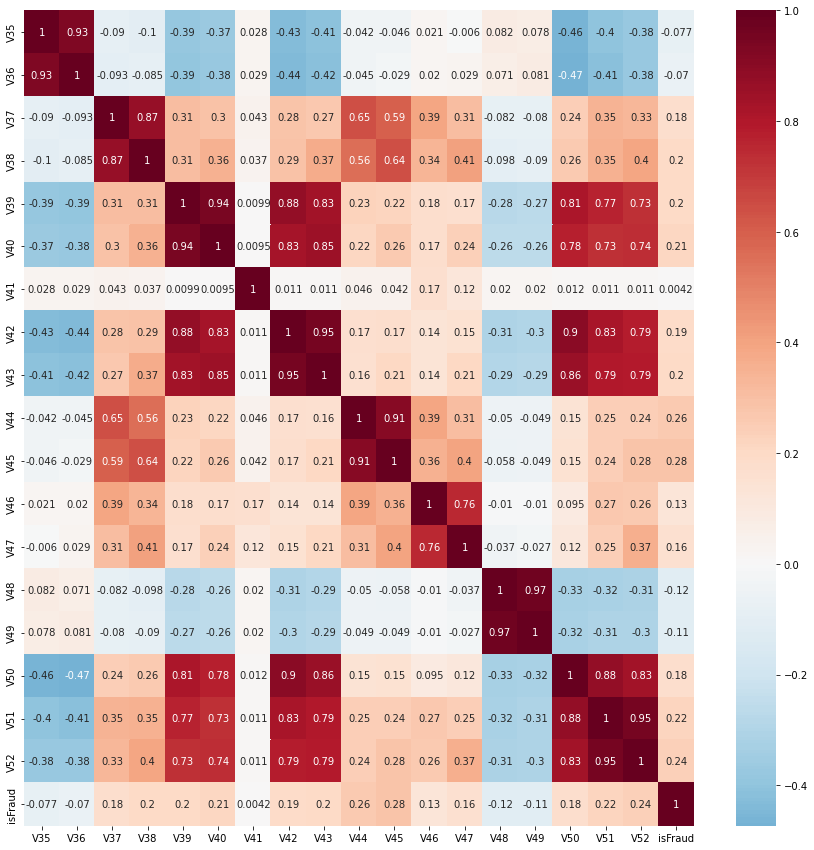

In [26]:
# correlation of group 3 v-columns within the group
# plt.figure(figsize=(15,15))
# sns.heatmap(train_transaction[v_group_dict['grp3']].corr(), cmap='RdBu_r', annot=True, center=0.0)
grp3_high_corr_pairs, grp3_correlationMatrix, grp3_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(15,15),corrThresh,v_group_dict['grp3']+['isFraud'])

In [27]:
# extract the results from grp3

vgrp3_retain_cols = list(set(v_group_dict['grp3']) - set(grp3_todrop))
v_grp3_dict_results = {'Columns':(v_group_dict['grp3']),
               'num columns':len(v_group_dict['grp3']),
               'Dropping Columns':grp3_todrop,
               'Num Columns Dropped':len(grp3_todrop),
               'Retain Columns':vgrp3_retain_cols,
               'Num Columns Retained': len(vgrp3_retain_cols)}
v_grp3_dict_results

{'Columns': ['V35',
  'V36',
  'V37',
  'V38',
  'V39',
  'V40',
  'V41',
  'V42',
  'V43',
  'V44',
  'V45',
  'V46',
  'V47',
  'V48',
  'V49',
  'V50',
  'V51',
  'V52'],
 'num columns': 18,
 'Dropping Columns': ['V36',
  'V38',
  'V40',
  'V42',
  'V43',
  'V45',
  'V47',
  'V49',
  'V50',
  'V51',
  'V52'],
 'Num Columns Dropped': 11,
 'Retain Columns': ['V46', 'V35', 'V48', 'V37', 'V41', 'V44', 'V39'],
 'Num Columns Retained': 7}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


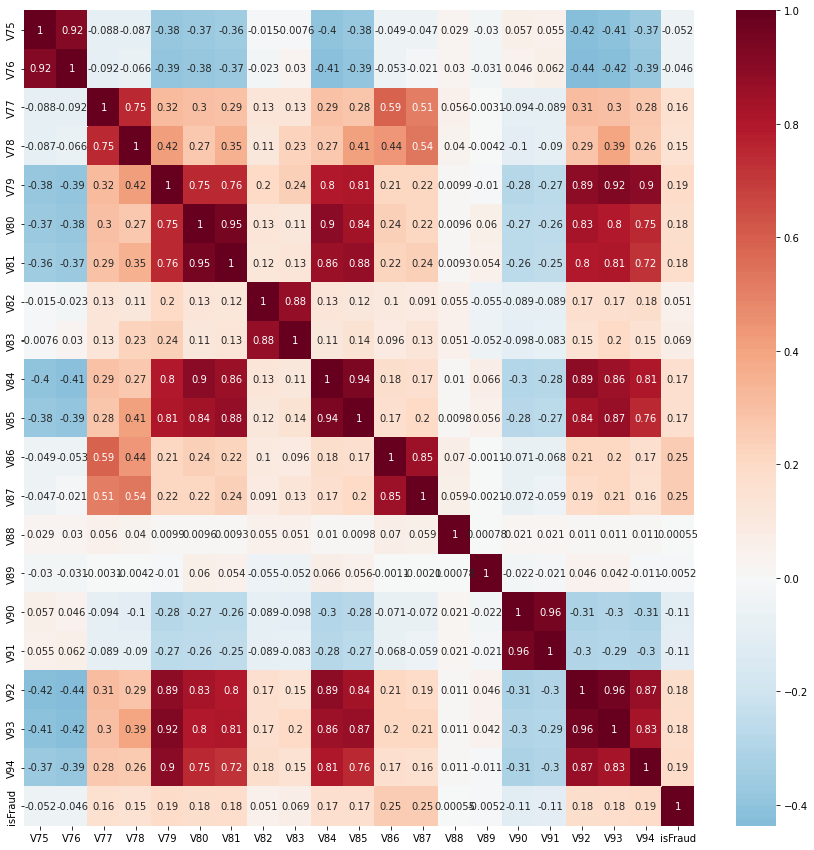

In [28]:
# correlation of group 5 v-columns within the group
# plt.figure(figsize=(15,15))
# sns.heatmap(train_transaction[v_group_dict['grp5']].corr(), cmap='RdBu_r', annot=True, center=0.0)
grp5_high_corr_pairs, grp5_correlationMatrix, grp5_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(15,15),corrThresh,v_group_dict['grp5']+['isFraud'])

In [29]:
# extract the results from grp5

vgrp5_retain_cols = list(set(v_group_dict['grp5']) - set(grp5_todrop))
v_grp5_dict_results = {'Columns':(v_group_dict['grp5']),
               'num columns':len(v_group_dict['grp5']),
               'Dropping Columns':grp5_todrop,
               'Num Columns Dropped':len(grp5_todrop),
               'Retain Columns':vgrp5_retain_cols,
               'Num Columns Retained': len(vgrp5_retain_cols)}
v_grp5_dict_results

{'Columns': ['V75',
  'V76',
  'V77',
  'V78',
  'V79',
  'V80',
  'V81',
  'V82',
  'V83',
  'V84',
  'V85',
  'V86',
  'V87',
  'V88',
  'V89',
  'V90',
  'V91',
  'V92',
  'V93',
  'V94'],
 'num columns': 20,
 'Dropping Columns': ['V76',
  'V78',
  'V80',
  'V81',
  'V83',
  'V84',
  'V85',
  'V87',
  'V91',
  'V92',
  'V93',
  'V94'],
 'Num Columns Dropped': 12,
 'Retain Columns': ['V79', 'V90', 'V88', 'V86', 'V82', 'V75', 'V77', 'V89'],
 'Num Columns Retained': 8}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


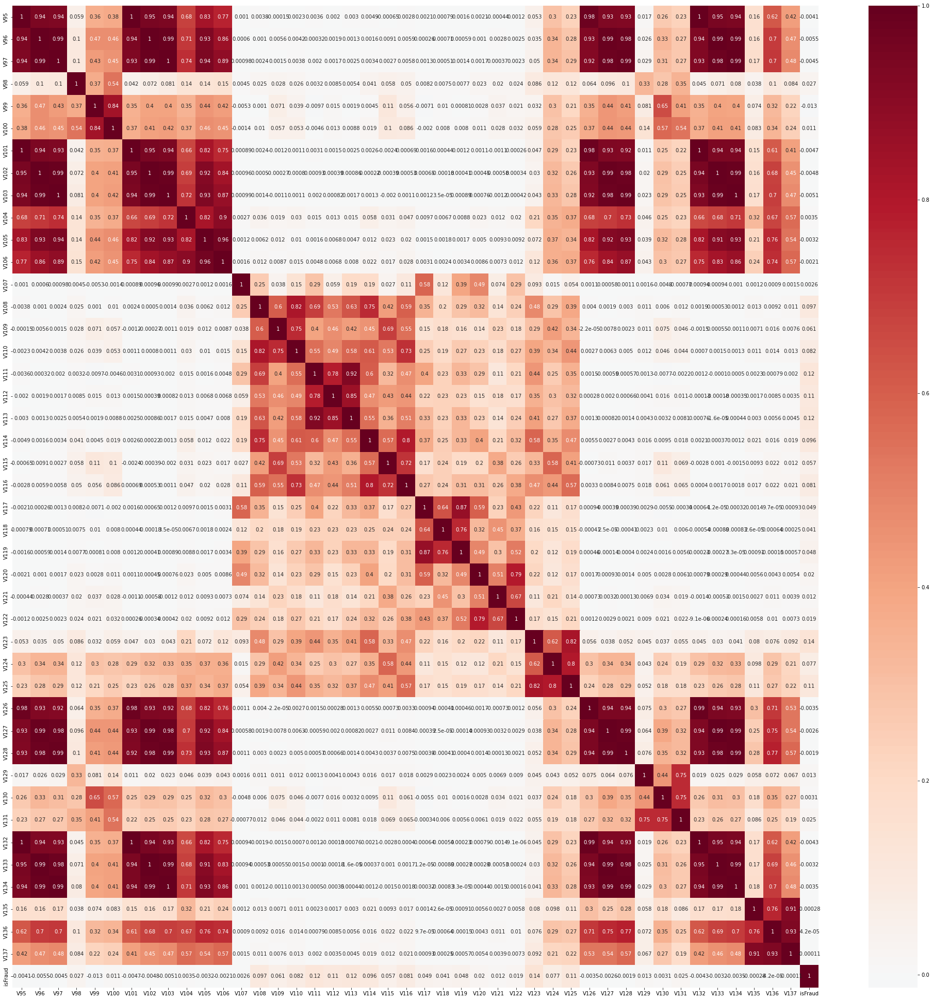

In [30]:
# correlation of group 6 v-columns within the group
# plt.figure(figsize=(35,35))
# sns.heatmap(train_transaction[v_group_dict['grp6']].corr(), cmap='RdBu_r', annot=True, center=0.0)
grp6_high_corr_pairs, grp6_correlationMatrix, grp6_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35),corrThresh,v_group_dict['grp6']+['isFraud'])

In [31]:
# extract the results from grp6

vgrp6_retain_cols = list(set(v_group_dict['grp6']) - set(grp6_todrop))
v_grp6_dict_results = {'Columns':(v_group_dict['grp6']),
               'num columns':len(v_group_dict['grp6']),
               'Dropping Columns':grp6_todrop,
               'Num Columns Dropped':len(grp6_todrop),
               'Retain Columns':vgrp6_retain_cols,
               'Num Columns Retained': len(vgrp6_retain_cols)}
v_grp6_dict_results

{'Columns': ['V95',
  'V96',
  'V97',
  'V98',
  'V99',
  'V100',
  'V101',
  'V102',
  'V103',
  'V104',
  'V105',
  'V106',
  'V107',
  'V108',
  'V109',
  'V110',
  'V111',
  'V112',
  'V113',
  'V114',
  'V115',
  'V116',
  'V117',
  'V118',
  'V119',
  'V120',
  'V121',
  'V122',
  'V123',
  'V124',
  'V125',
  'V126',
  'V127',
  'V128',
  'V129',
  'V130',
  'V131',
  'V132',
  'V133',
  'V134',
  'V135',
  'V136',
  'V137'],
 'num columns': 43,
 'Dropping Columns': ['V96',
  'V97',
  'V100',
  'V101',
  'V102',
  'V103',
  'V104',
  'V105',
  'V106',
  'V110',
  'V111',
  'V112',
  'V113',
  'V114',
  'V115',
  'V116',
  'V119',
  'V122',
  'V125',
  'V126',
  'V127',
  'V128',
  'V130',
  'V131',
  'V132',
  'V133',
  'V134',
  'V136',
  'V137'],
 'Num Columns Dropped': 29,
 'Retain Columns': ['V117',
  'V99',
  'V129',
  'V124',
  'V121',
  'V108',
  'V123',
  'V95',
  'V120',
  'V98',
  'V109',
  'V135',
  'V118',
  'V107'],
 'Num Columns Retained': 14}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


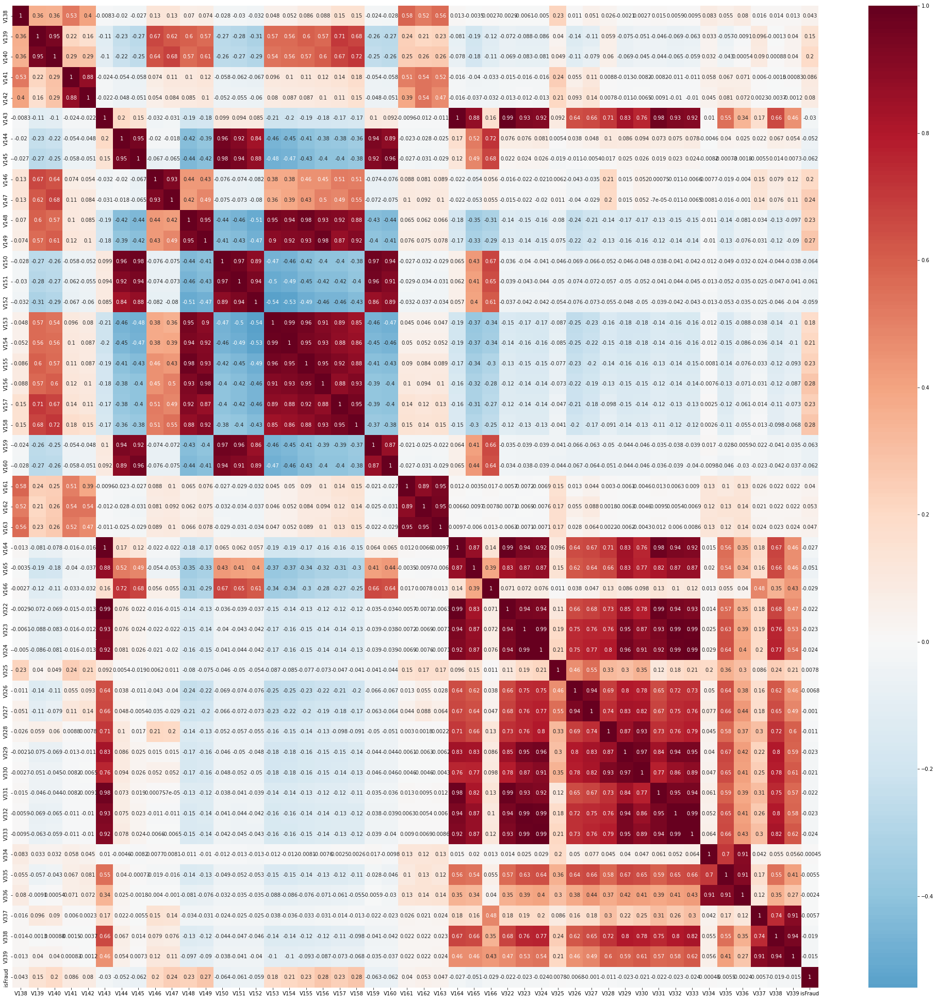

In [32]:
# correlation of group 7 and 11 v-columns within the group
# plt.figure(figsize=(35,35))
# sns.heatmap(train_transaction[v_group_dict['grp7']+v_group_dict['grp11']].corr(), cmap='RdBu_r', annot=True, center=0.0)
grp7n11_high_corr_pairs, grp7n11_correlationMatrix, grp7n11_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35),corrThresh,v_group_dict['grp7']+v_group_dict['grp11']+['isFraud'])

In [33]:
# extract the results from grp7 and grp11

vgrp7n11_retain_cols = list(set(v_group_dict['grp7']+v_group_dict['grp11']) - set(grp7n11_todrop))
v_grp7n11_dict_results = {'Columns':(v_group_dict['grp7']+v_group_dict['grp11']),
               'num columns':len(v_group_dict['grp7']+v_group_dict['grp11']),
               'Dropping Columns':grp7n11_todrop,
               'Num Columns Dropped':len(grp7n11_todrop),
               'Retain Columns':vgrp7n11_retain_cols,
               'Num Columns Retained': len(vgrp7n11_retain_cols)}
v_grp7n11_dict_results

{'Columns': ['V138',
  'V139',
  'V140',
  'V141',
  'V142',
  'V143',
  'V144',
  'V145',
  'V146',
  'V147',
  'V148',
  'V149',
  'V150',
  'V151',
  'V152',
  'V153',
  'V154',
  'V155',
  'V156',
  'V157',
  'V158',
  'V159',
  'V160',
  'V161',
  'V162',
  'V163',
  'V164',
  'V165',
  'V166',
  'V322',
  'V323',
  'V324',
  'V325',
  'V326',
  'V327',
  'V328',
  'V329',
  'V330',
  'V331',
  'V332',
  'V333',
  'V334',
  'V335',
  'V336',
  'V337',
  'V338',
  'V339'],
 'num columns': 47,
 'Dropping Columns': ['V140',
  'V142',
  'V145',
  'V146',
  'V147',
  'V149',
  'V150',
  'V151',
  'V152',
  'V153',
  'V154',
  'V155',
  'V156',
  'V157',
  'V158',
  'V159',
  'V160',
  'V162',
  'V163',
  'V164',
  'V165',
  'V166',
  'V322',
  'V323',
  'V324',
  'V326',
  'V327',
  'V328',
  'V329',
  'V330',
  'V331',
  'V332',
  'V333',
  'V335',
  'V336',
  'V338',
  'V339'],
 'Num Columns Dropped': 37,
 'Retain Columns': ['V144',
  'V143',
  'V138',
  'V334',
  'V161',
  'V141',
 

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


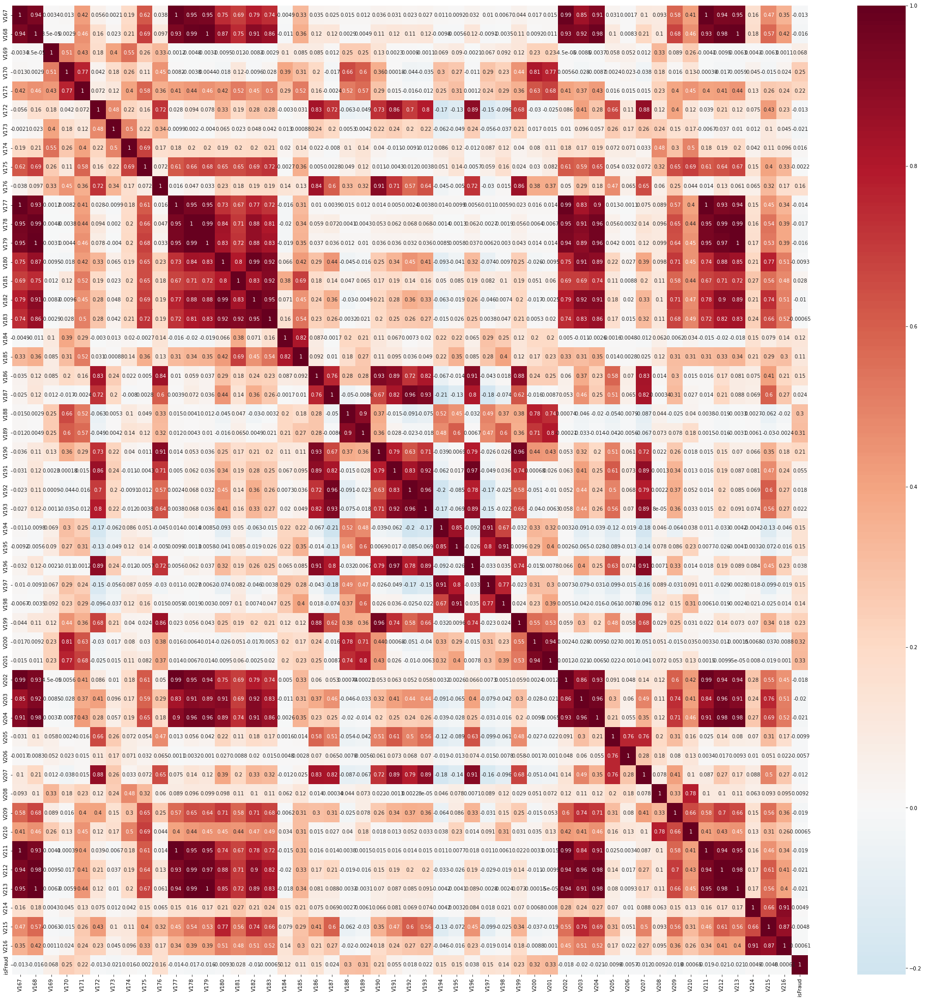

In [34]:
# correlation of group 8 v-columns within the group
# plt.figure(figsize=(35,35))

grp8_high_corr_pairs, grp8_correlationMatrix, grp8_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35),corrThresh,v_group_dict['grp8']+['isFraud'])


In [35]:
# extract the results from grp8

vgrp8_retain_cols = list(set(v_group_dict['grp8']) - set(grp8_todrop))
v_grp8_dict_results = {'Columns':(v_group_dict['grp8']),
               'num columns':len(v_group_dict['grp8']),
               'Dropping Columns':grp8_todrop,
               'Num Columns Dropped':len(grp8_todrop),
               'Retain Columns':vgrp8_retain_cols,
               'Num Columns Retained': len(vgrp8_retain_cols)}
v_grp8_dict_results

{'Columns': ['V167',
  'V168',
  'V169',
  'V170',
  'V171',
  'V172',
  'V173',
  'V174',
  'V175',
  'V176',
  'V177',
  'V178',
  'V179',
  'V180',
  'V181',
  'V182',
  'V183',
  'V184',
  'V185',
  'V186',
  'V187',
  'V188',
  'V189',
  'V190',
  'V191',
  'V192',
  'V193',
  'V194',
  'V195',
  'V196',
  'V197',
  'V198',
  'V199',
  'V200',
  'V201',
  'V202',
  'V203',
  'V204',
  'V205',
  'V206',
  'V207',
  'V208',
  'V209',
  'V210',
  'V211',
  'V212',
  'V213',
  'V214',
  'V215',
  'V216'],
 'num columns': 50,
 'Dropping Columns': ['V168',
  'V171',
  'V175',
  'V176',
  'V177',
  'V178',
  'V179',
  'V180',
  'V181',
  'V182',
  'V183',
  'V185',
  'V186',
  'V187',
  'V188',
  'V189',
  'V190',
  'V191',
  'V192',
  'V193',
  'V195',
  'V196',
  'V197',
  'V198',
  'V199',
  'V200',
  'V201',
  'V202',
  'V203',
  'V204',
  'V205',
  'V206',
  'V207',
  'V209',
  'V210',
  'V211',
  'V212',
  'V213',
  'V215',
  'V216'],
 'Num Columns Dropped': 40,
 'Retain Columns': 

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


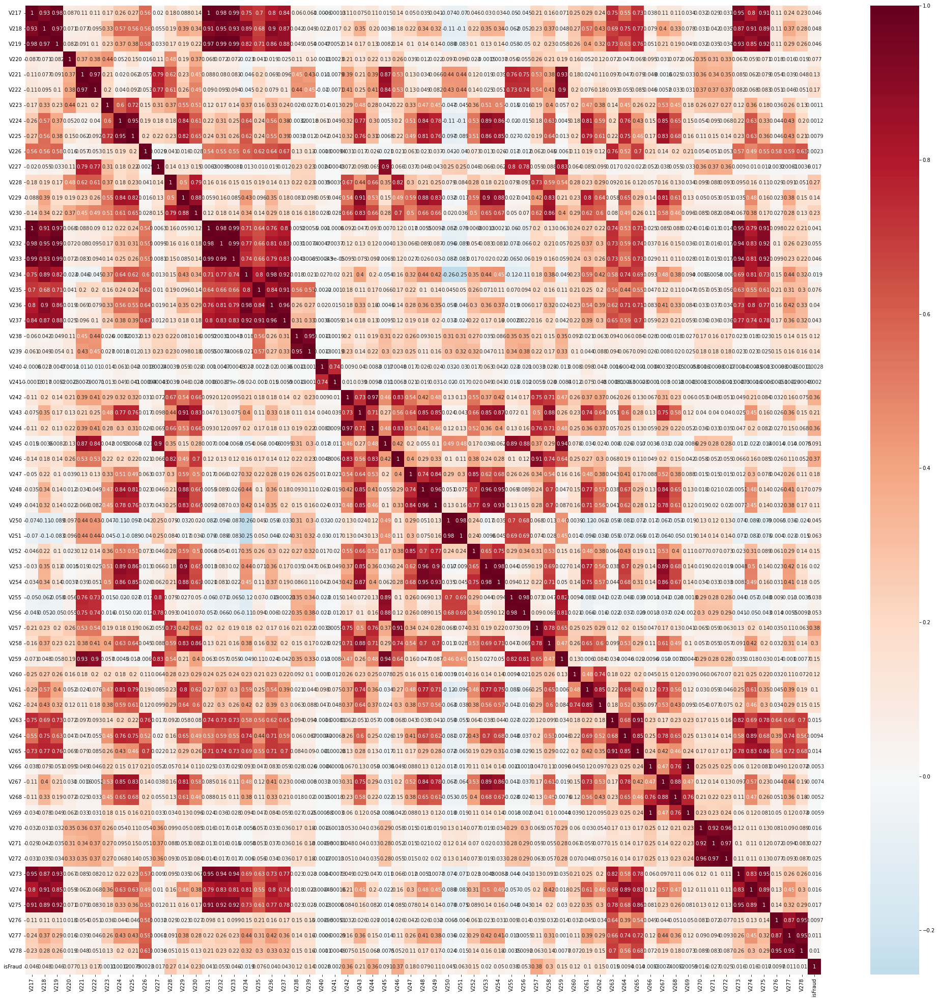

In [36]:
# correlation of group 9 v-columns within the group
# plt.figure(figsize=(35,35))

grp9_high_corr_pairs, grp9_correlationMatrix, grp9_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35), corrThresh, v_group_dict['grp9']+['isFraud'])


In [37]:
# extract the results from grp9

vgrp9_retain_cols = list(set(v_group_dict['grp9']) - set(grp9_todrop))
v_grp9_dict_results = {'Columns':(v_group_dict['grp9']),
               'num columns':len(v_group_dict['grp9']),
               'Dropping Columns':grp9_todrop,
               'Num Columns Dropped':len(grp9_todrop),
               'Retain Columns':vgrp9_retain_cols,
               'Num Columns Retained': len(vgrp9_retain_cols)}
v_grp9_dict_results

{'Columns': ['V217',
  'V218',
  'V219',
  'V220',
  'V221',
  'V222',
  'V223',
  'V224',
  'V225',
  'V226',
  'V227',
  'V228',
  'V229',
  'V230',
  'V231',
  'V232',
  'V233',
  'V234',
  'V235',
  'V236',
  'V237',
  'V238',
  'V239',
  'V240',
  'V241',
  'V242',
  'V243',
  'V244',
  'V245',
  'V246',
  'V247',
  'V248',
  'V249',
  'V250',
  'V251',
  'V252',
  'V253',
  'V254',
  'V255',
  'V256',
  'V257',
  'V258',
  'V259',
  'V260',
  'V261',
  'V262',
  'V263',
  'V264',
  'V265',
  'V266',
  'V267',
  'V268',
  'V269',
  'V270',
  'V271',
  'V272',
  'V273',
  'V274',
  'V275',
  'V276',
  'V277',
  'V278'],
 'num columns': 62,
 'Dropping Columns': ['V218',
  'V219',
  'V222',
  'V225',
  'V227',
  'V229',
  'V230',
  'V231',
  'V232',
  'V233',
  'V234',
  'V235',
  'V236',
  'V237',
  'V239',
  'V241',
  'V242',
  'V243',
  'V244',
  'V245',
  'V246',
  'V248',
  'V249',
  'V251',
  'V252',
  'V253',
  'V254',
  'V255',
  'V256',
  'V257',
  'V258',
  'V259',
  'V261'

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


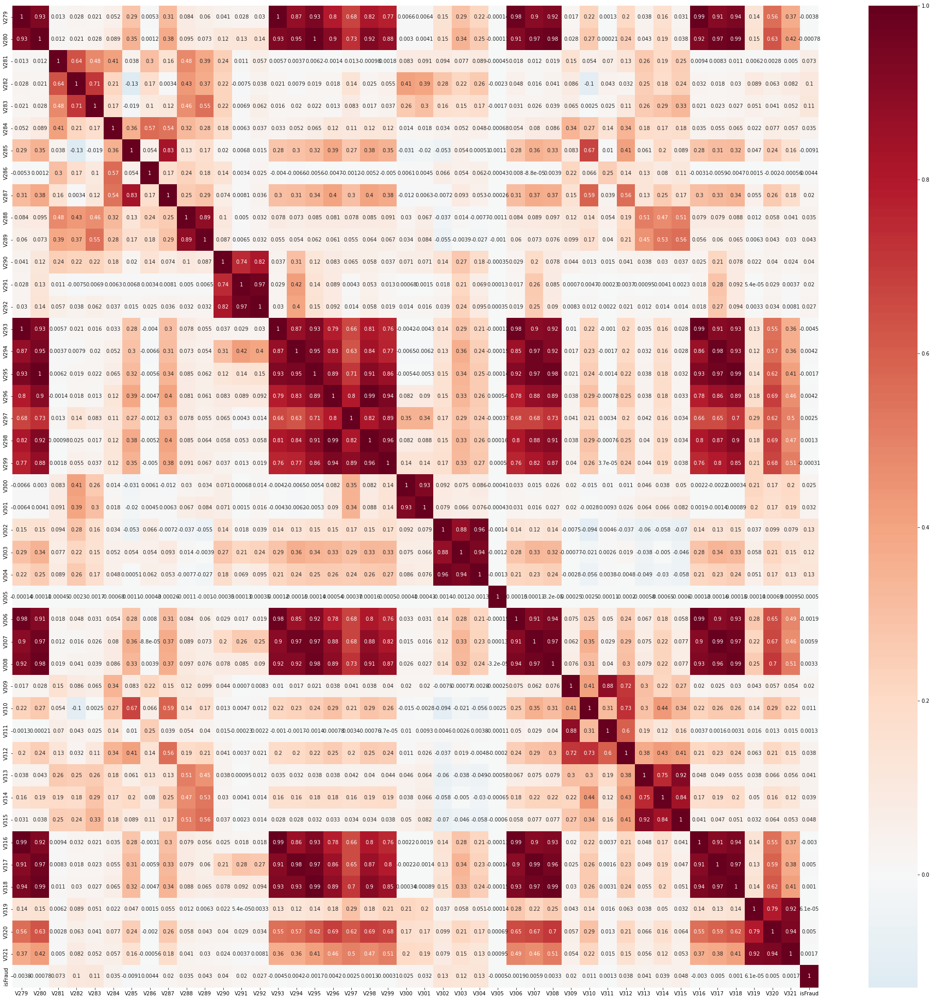

In [38]:
# correlation of group 10 v-columns within the group
# plt.figure(figsize=(35,35))

grp10_high_corr_pairs, grp10_correlationMatrix, grp10_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35), corrThresh, v_group_dict['grp10']+['isFraud'])


In [39]:
# extract the results from grp10

vgrp10_retain_cols = list(set(v_group_dict['grp10']) - set(grp10_todrop))
v_grp10_dict_results = {'Columns':(v_group_dict['grp10']),
               'num columns':len(v_group_dict['grp10']),
               'Dropping Columns':grp10_todrop,
               'Num Columns Dropped':len(grp10_todrop),
               'Retain Columns':vgrp10_retain_cols,
               'Num Columns Retained': len(vgrp10_retain_cols)}
v_grp10_dict_results

{'Columns': ['V279',
  'V280',
  'V281',
  'V282',
  'V283',
  'V284',
  'V285',
  'V286',
  'V287',
  'V288',
  'V289',
  'V290',
  'V291',
  'V292',
  'V293',
  'V294',
  'V295',
  'V296',
  'V297',
  'V298',
  'V299',
  'V300',
  'V301',
  'V302',
  'V303',
  'V304',
  'V305',
  'V306',
  'V307',
  'V308',
  'V309',
  'V310',
  'V311',
  'V312',
  'V313',
  'V314',
  'V315',
  'V316',
  'V317',
  'V318',
  'V319',
  'V320',
  'V321'],
 'num columns': 43,
 'Dropping Columns': ['V280',
  'V283',
  'V287',
  'V289',
  'V291',
  'V292',
  'V293',
  'V294',
  'V295',
  'V296',
  'V297',
  'V298',
  'V299',
  'V301',
  'V303',
  'V304',
  'V306',
  'V307',
  'V308',
  'V310',
  'V311',
  'V312',
  'V314',
  'V315',
  'V316',
  'V317',
  'V318',
  'V320',
  'V321'],
 'Num Columns Dropped': 29,
 'Retain Columns': ['V286',
  'V300',
  'V290',
  'V288',
  'V319',
  'V282',
  'V279',
  'V284',
  'V309',
  'V285',
  'V313',
  'V305',
  'V302',
  'V281'],
 'Num Columns Retained': 14}

#### **Summary of EDA of V1- V339**

Based on the analysis we conducted on the complete dataset and fraudulent dataset alone, we subsetted the data consisting of features that were enriched based on the groups that they belonged and started with the V-group first.

Since these columns contained a lot of null values, the 11 subsetted group of features were analyzed for their amount of null values. The visual analysis portryed that these features exhibited nullvalues counts as groups. Hence we split the V-columns into groups of V-columns based on their null values by visual inspection. These sub groups of V-columns were also further analysed for any additional details regarding their null structure. Sice there wan't more information that we could derive out of these sub-groups further, we proceeded to the next step of the analysis.

In the next step, we analysed each individual subgroup of the v-column, that was constructed based on their null structure in the previous step, for possible correlations of the features within that subgroup. 

We found that a lot features were correlated within each subgroup among all the 11 subgroups. Hence we set a threshold value of 0.65 as correlation coeeficient to drop the column that exhibited correlation beyond this threshold. 

The number of V-columns that were retianed at every step of the corelation analysis would be concateneated and further analysed in the following steps.

Also following the same appraoch we tried to find if there were v-columns that portrayed similar null structure as the null value percentage was very less in subdataset containg only the fraudulent data. This could be beneficial find any patterns of similarity or difference in null structure that could be more prominant or unique to the fradualent data alone. 

### EDA of V1-V339 of Fraudulent dataframe

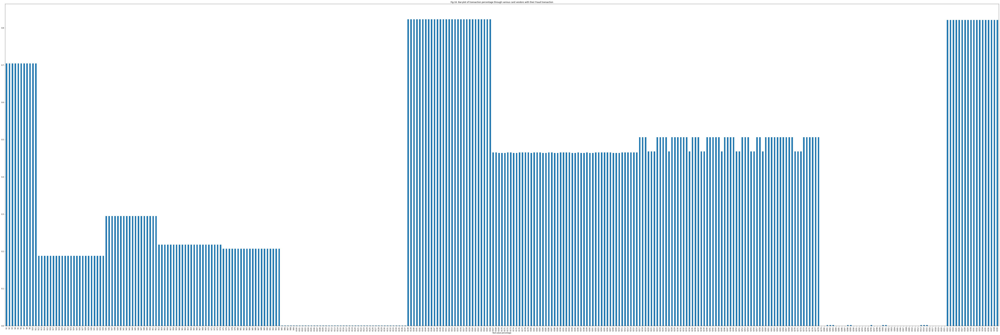

In [40]:
# Bar chart of the V-columns based on the null values

isfraudt_null_columns_prcnt = isfraudt_df.isna().sum()/isfraudt_df.shape[0]
isfraudt_colsToPlot = ['V' + str(i) for i in range(1,340)]
plt.figure(figsize=(105,35))
isfraudt_null_columns_prcnt[isfraudt_colsToPlot].plot(kind='bar')
plt.title("Fig-16: Bar-plot of transaction percentage through various card vendors with their Fraud transaction")
plt.xlabel('Null-value percentage')
plt.show()

Text(0.5, 1.1, 'Fig-17: Bar plot of the feature engineered columns separated by groups')

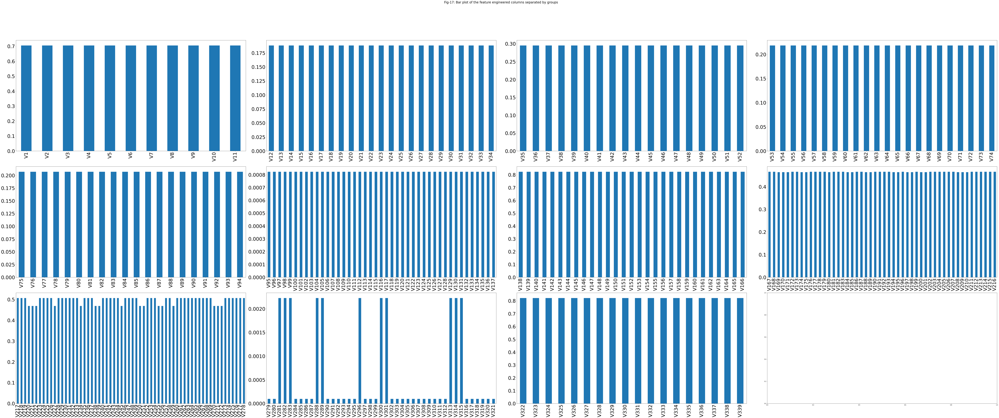

In [41]:
# Creating a dictionary of the groups of V-columns to create subplots of the groups to visualize null values
# Grouping the V-columns based on their percentage of null values

isfraudt_v_group_dict = {'ftgrp1':['V' + str(i) for i in range(1,12)],
                'ftgrp2':['V' + str(i) for i in range(12,35)],
                'ftgrp3':['V' + str(i) for i in range(35,53)],
                'ftgrp4':['V' + str(i) for i in range(53,75)],
                'ftgrp5':['V' + str(i) for i in range(75,95)],
                'ftgrp6':['V' + str(i) for i in range(95,138)],
                'ftgrp7':['V' + str(i) for i in range(138,167)],
                'ftgrp8':['V' + str(i) for i in range(167,217)],
                'ftgrp9':['V' + str(i) for i in range(217,279)],
                'ftgrp10':['V' + str(i) for i in range(279,322)],
                'ftgrp11':['V' + str(i) for i in range(322,340)]}

fig, axs = plt.subplots(nrows = 3, ncols=4, figsize = (105,40))
for name,ax in zip(isfraudt_v_group_dict.keys(),axs.flatten()):
  isfraudt_null_columns_prcnt[isfraudt_v_group_dict[name]].plot(ax=ax,kind='bar')
  ax.tick_params(axis='both', which='major', labelsize=37)

fig.tight_layout()
fig.suptitle('Fig-17: Bar plot of the feature engineered columns separated by groups',y=1.1,fontsize=24)

v138 - v166, v322-v339


<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


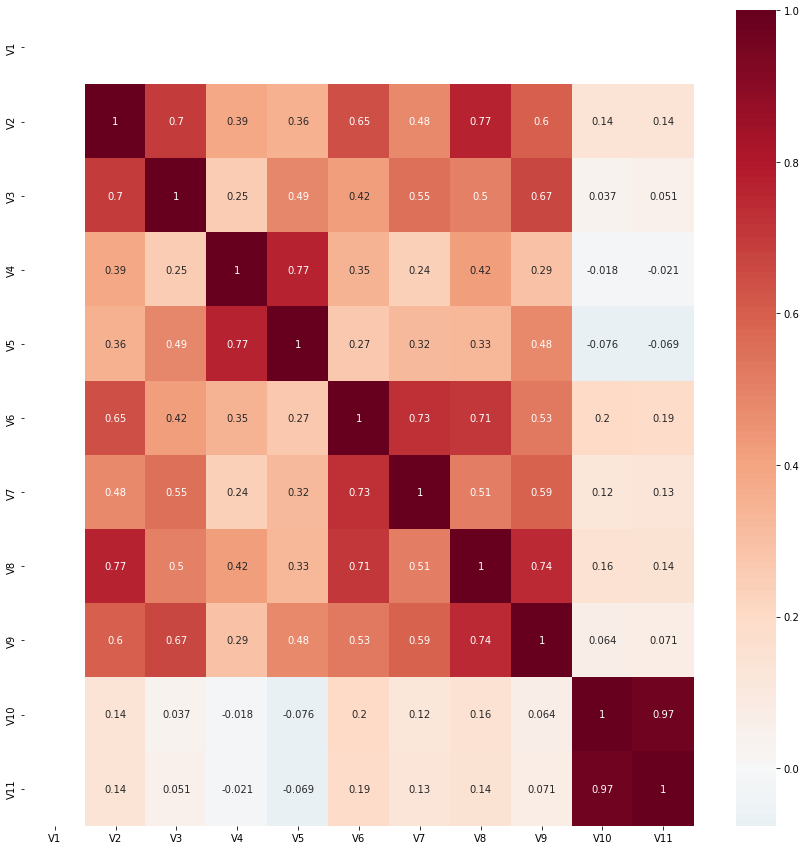

In [42]:
# Correlation of grp-1 with the target variable and within V columns
corrThresh = 0.65
ftgrp1_high_corr_pairs, ftgrp1_correlationMatrix, ftgrp1_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(15,15),corrThresh,isfraudt_v_group_dict['ftgrp1'])

The column V1 for fraud transaction contains only two values (NAN and 1.0) and hence the correlation of that column with any other column is resulting in NAN. Also we choose to retain this column irerspective of the previous cell's analysis choice we made as we notice the V1 column is significanlty different for the fraud transaction than the non-fraud transaction data indicating that it could be representing some information that distinguishes the two classes.  

In [43]:
# extract the results from ftgrp1

ftgrp1_retain_cols = list(set(isfraudt_v_group_dict['ftgrp1']) - set(ftgrp1_todrop))
ftv_grp1_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp1']),
               'num columns':len(isfraudt_v_group_dict['ftgrp1']),
               'Dropping Columns':ftgrp1_todrop,
               'Num Columns Dropped':len(ftgrp1_todrop),
               'Retain Columns':ftgrp1_retain_cols,
               'Num Columns Retained': len(ftgrp1_retain_cols)}
ftv_grp1_dict_results

{'Columns': ['V1',
  'V2',
  'V3',
  'V4',
  'V5',
  'V6',
  'V7',
  'V8',
  'V9',
  'V10',
  'V11'],
 'num columns': 11,
 'Dropping Columns': ['V3', 'V5', 'V7', 'V8', 'V9', 'V11'],
 'Num Columns Dropped': 6,
 'Retain Columns': ['V1', 'V10', 'V2', 'V6', 'V4'],
 'Num Columns Retained': 5}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


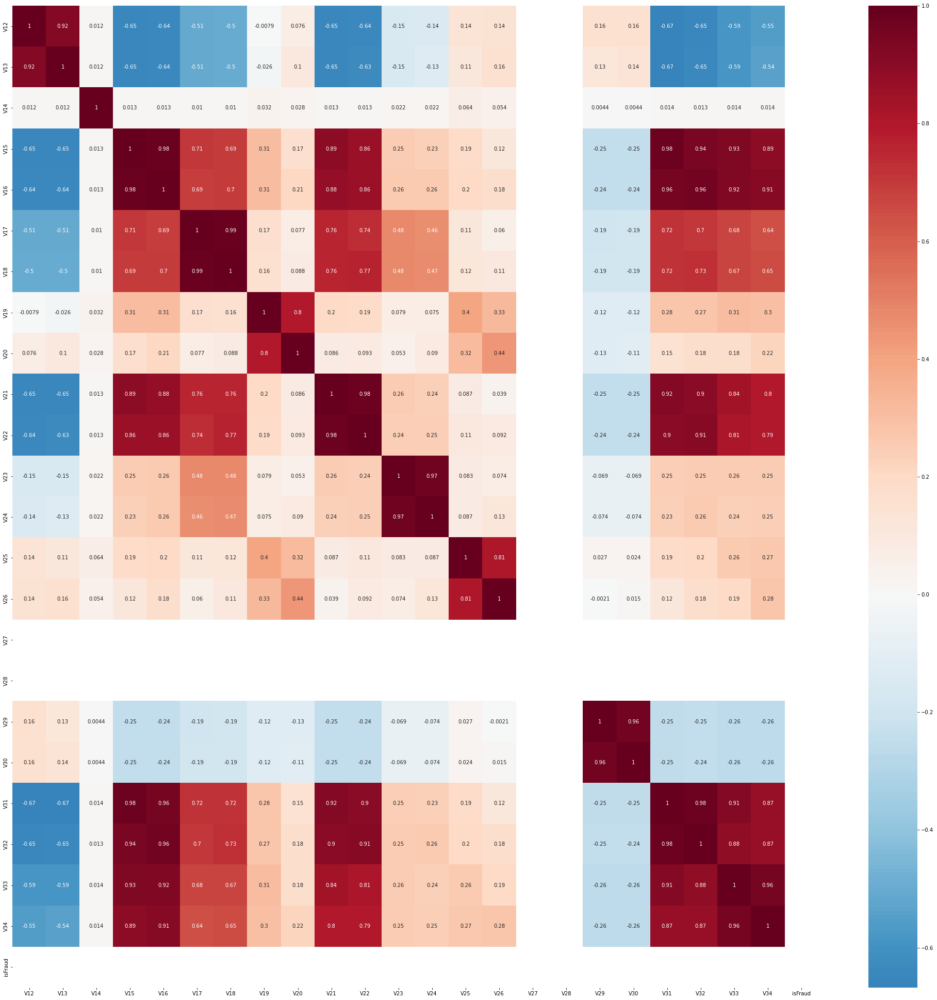

In [44]:
# correlation of group 2 v-columns within the group
# plt.figure(figsize=(35,35))
# grp2_correlationMatrix=train_transaction[v_group_dict['grp2']].corr()

ftgrp2_high_corr_pairs, ftgrp2_correlationMatrix, ftgrp2_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp2']+['isFraud'])


In [45]:
# extract the results from ftgrp2

ftgrp2_retain_cols = list(set(isfraudt_v_group_dict['ftgrp2']) - set(ftgrp2_todrop))
ftv_grp2_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp2']),
               'num columns':len(isfraudt_v_group_dict['ftgrp2']),
               'Dropping Columns':ftgrp2_todrop,
               'Num Columns Dropped':len(ftgrp2_todrop),
               'Retain Columns':ftgrp2_retain_cols,
               'Num Columns Retained': len(ftgrp2_retain_cols)}
ftv_grp2_dict_results

{'Columns': ['V12',
  'V13',
  'V14',
  'V15',
  'V16',
  'V17',
  'V18',
  'V19',
  'V20',
  'V21',
  'V22',
  'V23',
  'V24',
  'V25',
  'V26',
  'V27',
  'V28',
  'V29',
  'V30',
  'V31',
  'V32',
  'V33',
  'V34'],
 'num columns': 23,
 'Dropping Columns': ['V13',
  'V16',
  'V17',
  'V18',
  'V20',
  'V21',
  'V22',
  'V24',
  'V26',
  'V30',
  'V31',
  'V32',
  'V33',
  'V34'],
 'Num Columns Dropped': 14,
 'Retain Columns': ['V28',
  'V27',
  'V15',
  'V19',
  'V14',
  'V23',
  'V25',
  'V29',
  'V12'],
 'Num Columns Retained': 9}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


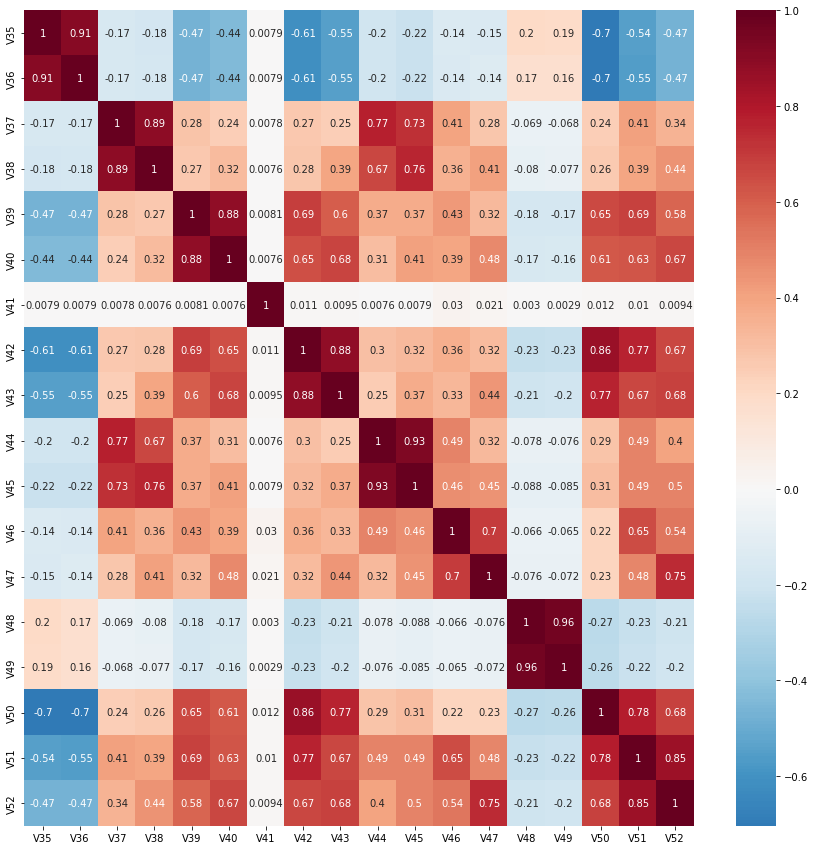

In [46]:
# correlation of group 3 v-columns within the group
ftgrp3_high_corr_pairs, ftgrp3_correlationMatrix, ftgrp3_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(15,15),corrThresh,isfraudt_v_group_dict['ftgrp3'])


In [47]:
# extract the results from ftgrp3

ftgrp3_retain_cols = list(set(isfraudt_v_group_dict['ftgrp3']) - set(ftgrp3_todrop))
ftv_grp3_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp3']),
               'num columns':len(isfraudt_v_group_dict['ftgrp3']),
               'Dropping Columns':ftgrp3_todrop,
               'Num Columns Dropped':len(ftgrp3_todrop),
               'Retain Columns':ftgrp3_retain_cols,
               'Num Columns Retained': len(ftgrp3_retain_cols)}
ftv_grp3_dict_results

{'Columns': ['V35',
  'V36',
  'V37',
  'V38',
  'V39',
  'V40',
  'V41',
  'V42',
  'V43',
  'V44',
  'V45',
  'V46',
  'V47',
  'V48',
  'V49',
  'V50',
  'V51',
  'V52'],
 'num columns': 18,
 'Dropping Columns': ['V36',
  'V38',
  'V40',
  'V42',
  'V43',
  'V44',
  'V45',
  'V47',
  'V49',
  'V50',
  'V51',
  'V52'],
 'Num Columns Dropped': 12,
 'Retain Columns': ['V46', 'V35', 'V48', 'V37', 'V41', 'V39'],
 'Num Columns Retained': 6}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


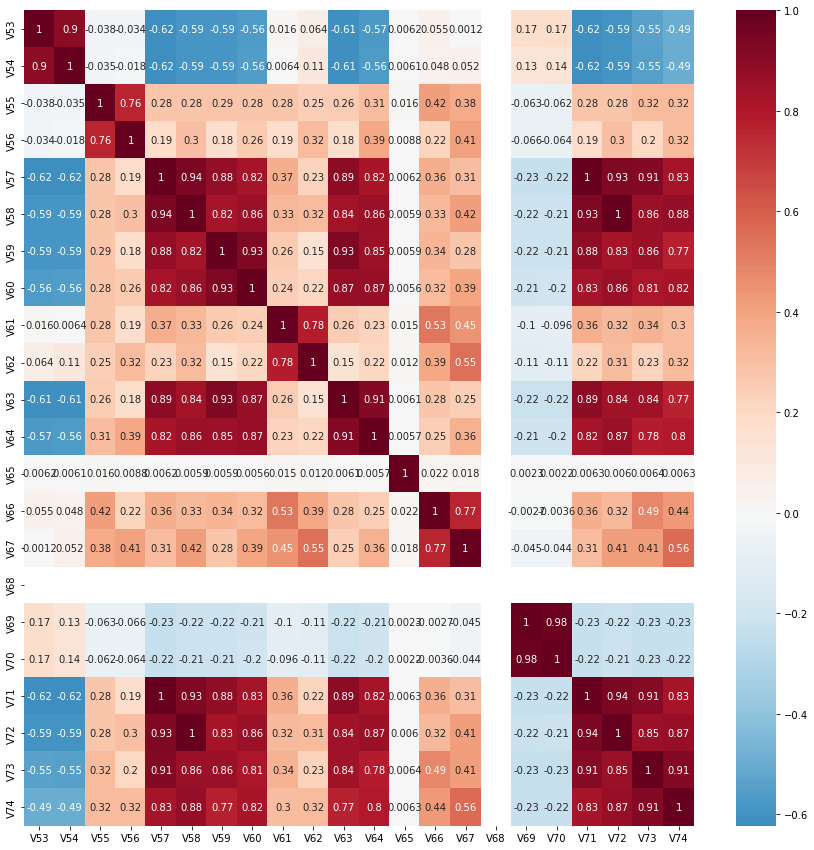

In [48]:
# correlation of group 4 v-columns within the group
ftgrp4_high_corr_pairs, ftgrp4_correlationMatrix, ftgrp4_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(15,15),corrThresh,isfraudt_v_group_dict['ftgrp4'])


In [49]:
# extract the results from ftgrp4

ftgrp4_retain_cols = list(set(isfraudt_v_group_dict['ftgrp4']) - set(ftgrp4_todrop))
ftv_grp4_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp4']),
               'num columns':len(isfraudt_v_group_dict['ftgrp4']),
               'Dropping Columns':ftgrp4_todrop,
               'Num Columns Dropped':len(ftgrp4_todrop),
               'Retain Columns':ftgrp4_retain_cols,
               'Num Columns Retained': len(ftgrp4_retain_cols)}
ftv_grp4_dict_results

{'Columns': ['V53',
  'V54',
  'V55',
  'V56',
  'V57',
  'V58',
  'V59',
  'V60',
  'V61',
  'V62',
  'V63',
  'V64',
  'V65',
  'V66',
  'V67',
  'V68',
  'V69',
  'V70',
  'V71',
  'V72',
  'V73',
  'V74'],
 'num columns': 22,
 'Dropping Columns': ['V54',
  'V56',
  'V58',
  'V59',
  'V60',
  'V62',
  'V63',
  'V64',
  'V67',
  'V70',
  'V71',
  'V72',
  'V73',
  'V74'],
 'Num Columns Dropped': 14,
 'Retain Columns': ['V57', 'V61', 'V53', 'V69', 'V66', 'V55', 'V65', 'V68'],
 'Num Columns Retained': 8}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


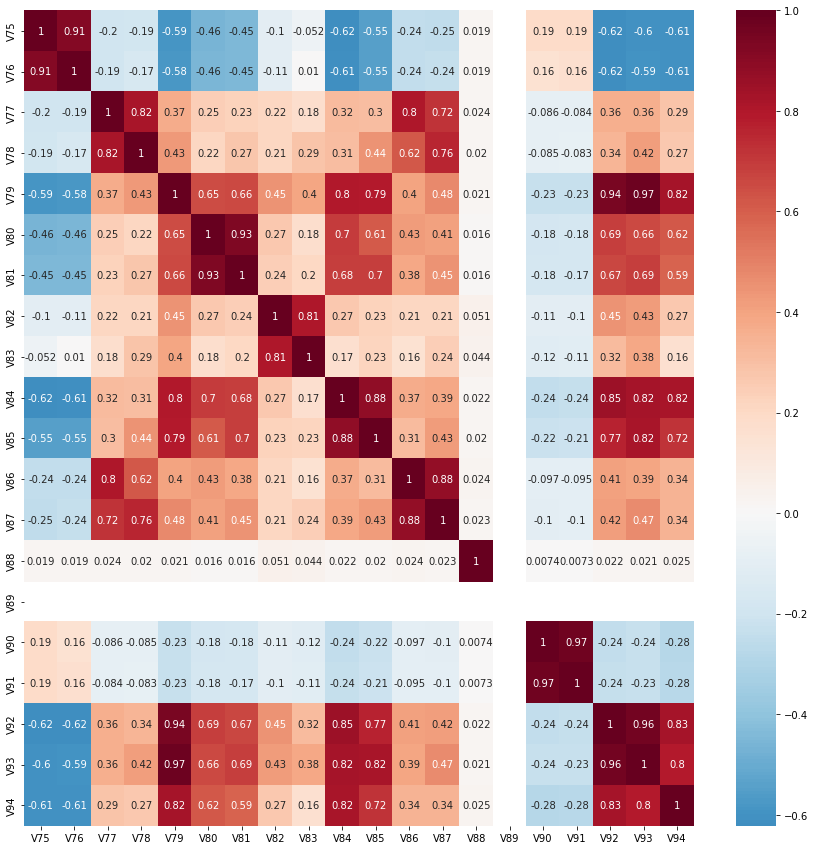

In [50]:
# correlation of group 5 v-columns within the group
ftgrp5_high_corr_pairs, ftgrp5_correlationMatrix, ftgrp5_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(15,15),corrThresh,isfraudt_v_group_dict['ftgrp5'])


In [51]:
# extract the results from ftgrp5

ftgrp5_retain_cols = list(set(isfraudt_v_group_dict['ftgrp5']) - set(ftgrp5_todrop))
ftv_grp5_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp5']),
               'num columns':len(isfraudt_v_group_dict['ftgrp5']),
               'Dropping Columns':ftgrp5_todrop,
               'Num Columns Dropped':len(ftgrp5_todrop),
               'Retain Columns':ftgrp5_retain_cols,
               'Num Columns Retained': len(ftgrp5_retain_cols)}
ftv_grp5_dict_results

{'Columns': ['V75',
  'V76',
  'V77',
  'V78',
  'V79',
  'V80',
  'V81',
  'V82',
  'V83',
  'V84',
  'V85',
  'V86',
  'V87',
  'V88',
  'V89',
  'V90',
  'V91',
  'V92',
  'V93',
  'V94'],
 'num columns': 20,
 'Dropping Columns': ['V76',
  'V78',
  'V81',
  'V83',
  'V84',
  'V85',
  'V86',
  'V87',
  'V91',
  'V92',
  'V93',
  'V94'],
 'Num Columns Dropped': 12,
 'Retain Columns': ['V79', 'V90', 'V88', 'V82', 'V80', 'V75', 'V77', 'V89'],
 'Num Columns Retained': 8}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


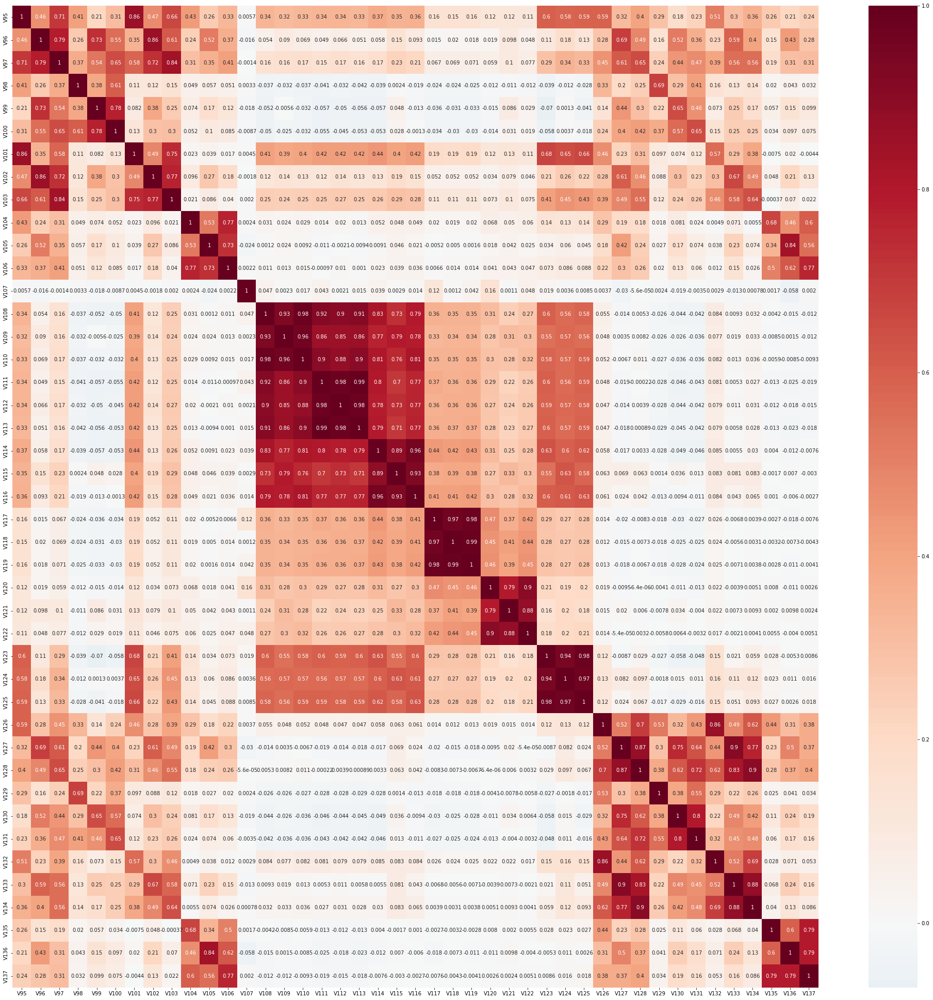

In [52]:
# correlation of group 6 v-columns within the group
ftgrp6_high_corr_pairs, ftgrp6_correlationMatrix, ftgrp6_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp6'])


In [53]:
# extract the results from ftgrp6

ftgrp6_retain_cols = list(set(isfraudt_v_group_dict['ftgrp6']) - set(ftgrp6_todrop))
ftv_grp6_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp6']),
               'num columns':len(isfraudt_v_group_dict['ftgrp6']),
               'Dropping Columns':ftgrp6_todrop,
               'Num Columns Dropped':len(ftgrp6_todrop),
               'Retain Columns':ftgrp6_retain_cols,
               'Num Columns Retained': len(ftgrp6_retain_cols)}
ftv_grp6_dict_results

{'Columns': ['V95',
  'V96',
  'V97',
  'V98',
  'V99',
  'V100',
  'V101',
  'V102',
  'V103',
  'V104',
  'V105',
  'V106',
  'V107',
  'V108',
  'V109',
  'V110',
  'V111',
  'V112',
  'V113',
  'V114',
  'V115',
  'V116',
  'V117',
  'V118',
  'V119',
  'V120',
  'V121',
  'V122',
  'V123',
  'V124',
  'V125',
  'V126',
  'V127',
  'V128',
  'V129',
  'V130',
  'V131',
  'V132',
  'V133',
  'V134',
  'V135',
  'V136',
  'V137'],
 'num columns': 43,
 'Dropping Columns': ['V97',
  'V99',
  'V100',
  'V101',
  'V102',
  'V103',
  'V106',
  'V109',
  'V110',
  'V111',
  'V112',
  'V113',
  'V114',
  'V115',
  'V116',
  'V118',
  'V119',
  'V121',
  'V122',
  'V123',
  'V124',
  'V125',
  'V127',
  'V128',
  'V129',
  'V130',
  'V131',
  'V132',
  'V133',
  'V134',
  'V135',
  'V136',
  'V137'],
 'Num Columns Dropped': 33,
 'Retain Columns': ['V105',
  'V117',
  'V108',
  'V126',
  'V95',
  'V104',
  'V120',
  'V98',
  'V96',
  'V107'],
 'Num Columns Retained': 10}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


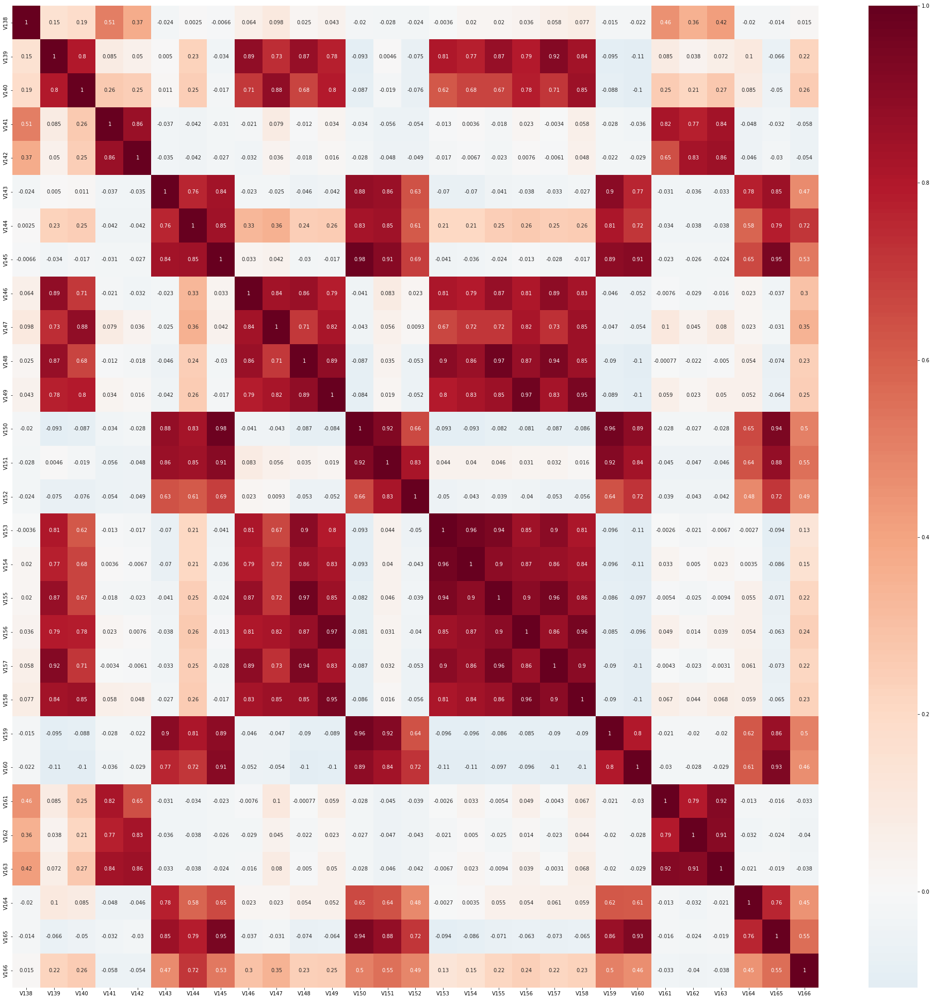

In [54]:
# correlation of group 7 v-columns within the group
ftgrp7_high_corr_pairs, ftgrp7_correlationMatrix, ftgrp7_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp7'])


In [55]:
# extract the results from ftgrp7

ftgrp7_retain_cols = list(set(isfraudt_v_group_dict['ftgrp7']) - set(ftgrp7_todrop))
ftv_grp7_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp7']),
               'num columns':len(isfraudt_v_group_dict['ftgrp7']),
               'Dropping Columns':ftgrp7_todrop,
               'Num Columns Dropped':len(ftgrp7_todrop),
               'Retain Columns':ftgrp7_retain_cols,
               'Num Columns Retained': len(ftgrp7_retain_cols)}
ftv_grp7_dict_results

{'Columns': ['V138',
  'V139',
  'V140',
  'V141',
  'V142',
  'V143',
  'V144',
  'V145',
  'V146',
  'V147',
  'V148',
  'V149',
  'V150',
  'V151',
  'V152',
  'V153',
  'V154',
  'V155',
  'V156',
  'V157',
  'V158',
  'V159',
  'V160',
  'V161',
  'V162',
  'V163',
  'V164',
  'V165',
  'V166'],
 'num columns': 29,
 'Dropping Columns': ['V140',
  'V142',
  'V144',
  'V145',
  'V146',
  'V147',
  'V148',
  'V149',
  'V150',
  'V151',
  'V152',
  'V153',
  'V154',
  'V155',
  'V156',
  'V157',
  'V158',
  'V159',
  'V160',
  'V161',
  'V162',
  'V163',
  'V164',
  'V165',
  'V166'],
 'Num Columns Dropped': 25,
 'Retain Columns': ['V139', 'V143', 'V138', 'V141'],
 'Num Columns Retained': 4}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


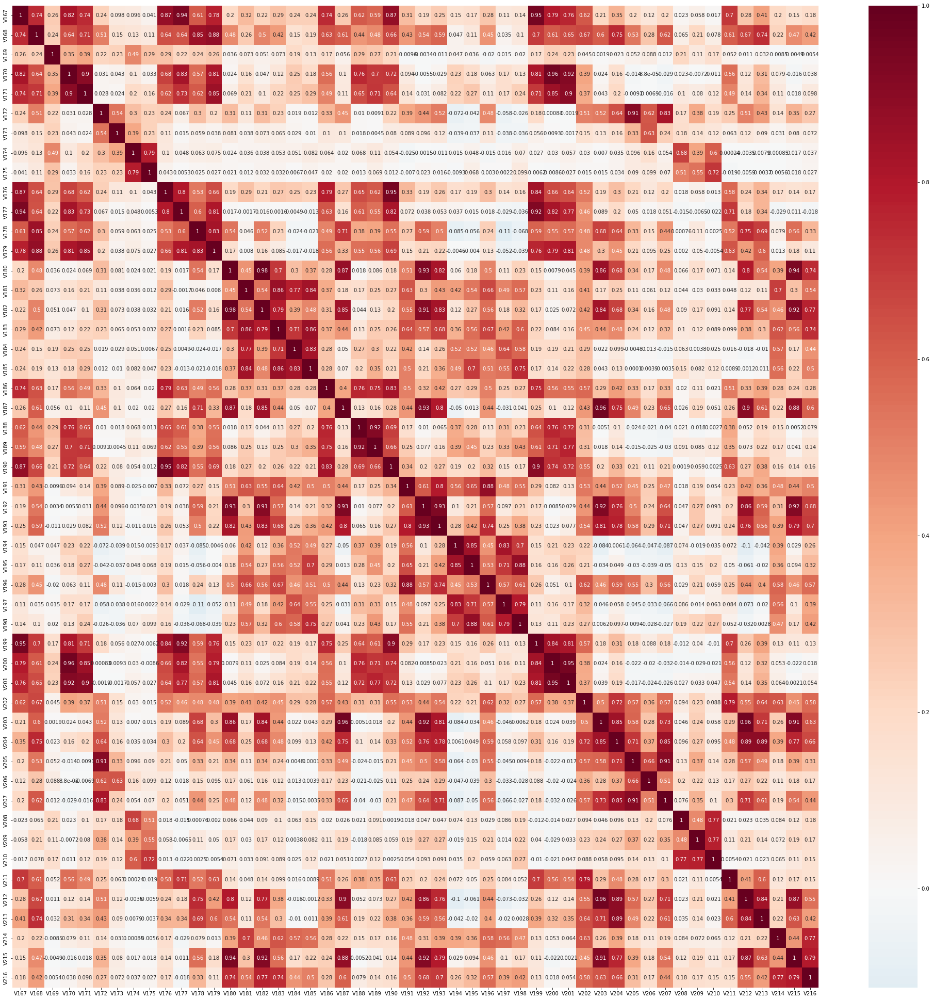

In [56]:
# correlation of group 8 v-columns within the group
ftgrp8_high_corr_pairs, ftgrp8_correlationMatrix, ftgrp8_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp8'])


In [57]:
# extract the results from ftgrp8

ftgrp8_retain_cols = list(set(isfraudt_v_group_dict['ftgrp8']) - set(ftgrp8_todrop))
ftv_grp8_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp8']),
               'num columns':len(isfraudt_v_group_dict['ftgrp8']),
               'Dropping Columns':ftgrp8_todrop,
               'Num Columns Dropped':len(ftgrp8_todrop),
               'Retain Columns':ftgrp8_retain_cols,
               'Num Columns Retained': len(ftgrp8_retain_cols)}
ftv_grp8_dict_results

{'Columns': ['V167',
  'V168',
  'V169',
  'V170',
  'V171',
  'V172',
  'V173',
  'V174',
  'V175',
  'V176',
  'V177',
  'V178',
  'V179',
  'V180',
  'V181',
  'V182',
  'V183',
  'V184',
  'V185',
  'V186',
  'V187',
  'V188',
  'V189',
  'V190',
  'V191',
  'V192',
  'V193',
  'V194',
  'V195',
  'V196',
  'V197',
  'V198',
  'V199',
  'V200',
  'V201',
  'V202',
  'V203',
  'V204',
  'V205',
  'V206',
  'V207',
  'V208',
  'V209',
  'V210',
  'V211',
  'V212',
  'V213',
  'V214',
  'V215',
  'V216'],
 'num columns': 50,
 'Dropping Columns': ['V168',
  'V170',
  'V171',
  'V175',
  'V176',
  'V177',
  'V178',
  'V179',
  'V182',
  'V183',
  'V184',
  'V185',
  'V186',
  'V187',
  'V188',
  'V189',
  'V190',
  'V192',
  'V193',
  'V195',
  'V196',
  'V197',
  'V198',
  'V199',
  'V200',
  'V201',
  'V202',
  'V203',
  'V204',
  'V205',
  'V206',
  'V207',
  'V208',
  'V210',
  'V211',
  'V212',
  'V213',
  'V214',
  'V215',
  'V216'],
 'Num Columns Dropped': 40,
 'Retain Columns': 

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


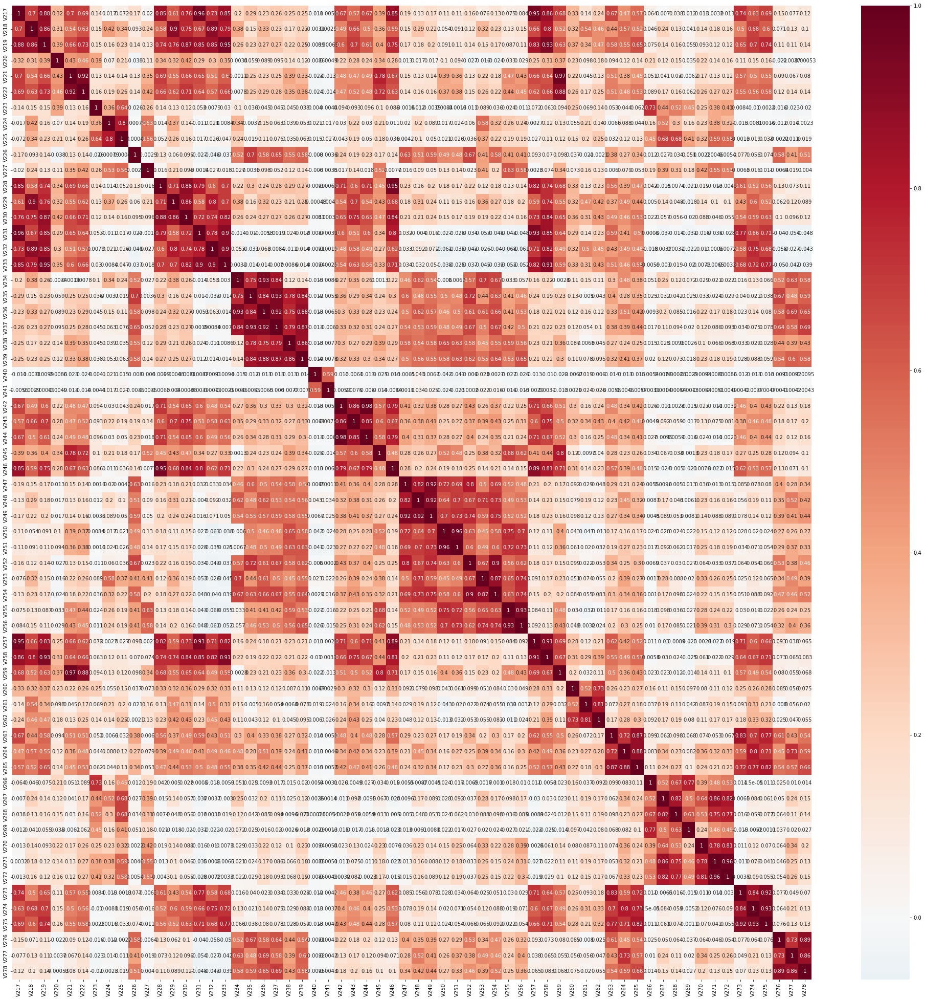

In [58]:
# correlation of group 9 v-columns within the group
ftgrp9_high_corr_pairs, ftgrp9_correlationMatrix, ftgrp9_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp9'])


In [59]:
# extract the results from ftgrp9

ftgrp9_retain_cols = list(set(isfraudt_v_group_dict['ftgrp9']) - set(ftgrp9_todrop))
ftv_grp9_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp9']),
               'num columns':len(isfraudt_v_group_dict['ftgrp9']),
               'Dropping Columns':ftgrp9_todrop,
               'Num Columns Dropped':len(ftgrp9_todrop),
               'Retain Columns':ftgrp9_retain_cols,
               'Num Columns Retained': len(ftgrp9_retain_cols)}
ftv_grp9_dict_results

{'Columns': ['V217',
  'V218',
  'V219',
  'V220',
  'V221',
  'V222',
  'V223',
  'V224',
  'V225',
  'V226',
  'V227',
  'V228',
  'V229',
  'V230',
  'V231',
  'V232',
  'V233',
  'V234',
  'V235',
  'V236',
  'V237',
  'V238',
  'V239',
  'V240',
  'V241',
  'V242',
  'V243',
  'V244',
  'V245',
  'V246',
  'V247',
  'V248',
  'V249',
  'V250',
  'V251',
  'V252',
  'V253',
  'V254',
  'V255',
  'V256',
  'V257',
  'V258',
  'V259',
  'V260',
  'V261',
  'V262',
  'V263',
  'V264',
  'V265',
  'V266',
  'V267',
  'V268',
  'V269',
  'V270',
  'V271',
  'V272',
  'V273',
  'V274',
  'V275',
  'V276',
  'V277',
  'V278'],
 'num columns': 62,
 'Dropping Columns': ['V218',
  'V219',
  'V221',
  'V222',
  'V225',
  'V228',
  'V229',
  'V230',
  'V231',
  'V232',
  'V233',
  'V235',
  'V236',
  'V237',
  'V238',
  'V239',
  'V242',
  'V243',
  'V244',
  'V245',
  'V246',
  'V248',
  'V249',
  'V250',
  'V251',
  'V252',
  'V253',
  'V254',
  'V255',
  'V256',
  'V257',
  'V258',
  'V259'

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


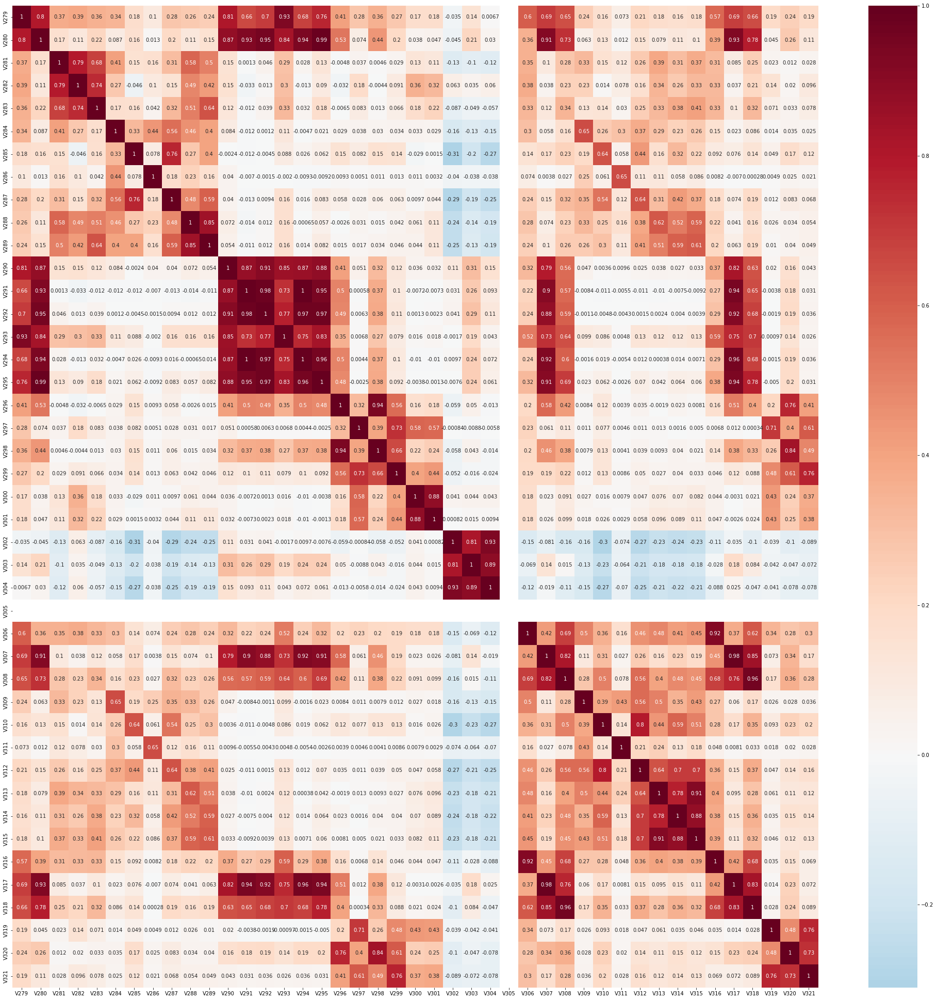

In [60]:
# correlation of group 10 v-columns within the group
ftgrp10_high_corr_pairs, ftgrp10_correlationMatrix, ftgrp10_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(35,35),corrThresh,isfraudt_v_group_dict['ftgrp10'])


In [61]:
# extract the results from ftgrp10

ftgrp10_retain_cols = list(set(isfraudt_v_group_dict['ftgrp10']) - set(ftgrp10_todrop))
ftv_grp10_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp10']),
               'num columns':len(isfraudt_v_group_dict['ftgrp10']),
               'Dropping Columns':ftgrp10_todrop,
               'Num Columns Dropped':len(ftgrp10_todrop),
               'Retain Columns':ftgrp10_retain_cols,
               'Num Columns Retained': len(ftgrp10_retain_cols)}
ftv_grp10_dict_results

{'Columns': ['V279',
  'V280',
  'V281',
  'V282',
  'V283',
  'V284',
  'V285',
  'V286',
  'V287',
  'V288',
  'V289',
  'V290',
  'V291',
  'V292',
  'V293',
  'V294',
  'V295',
  'V296',
  'V297',
  'V298',
  'V299',
  'V300',
  'V301',
  'V302',
  'V303',
  'V304',
  'V305',
  'V306',
  'V307',
  'V308',
  'V309',
  'V310',
  'V311',
  'V312',
  'V313',
  'V314',
  'V315',
  'V316',
  'V317',
  'V318',
  'V319',
  'V320',
  'V321'],
 'num columns': 43,
 'Dropping Columns': ['V280',
  'V282',
  'V283',
  'V287',
  'V289',
  'V290',
  'V291',
  'V292',
  'V293',
  'V294',
  'V295',
  'V298',
  'V299',
  'V301',
  'V303',
  'V304',
  'V307',
  'V308',
  'V309',
  'V311',
  'V312',
  'V314',
  'V315',
  'V316',
  'V317',
  'V318',
  'V319',
  'V320',
  'V321'],
 'Num Columns Dropped': 29,
 'Retain Columns': ['V286',
  'V300',
  'V297',
  'V296',
  'V288',
  'V279',
  'V284',
  'V285',
  'V306',
  'V310',
  'V313',
  'V305',
  'V302',
  'V281'],
 'Num Columns Retained': 14}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


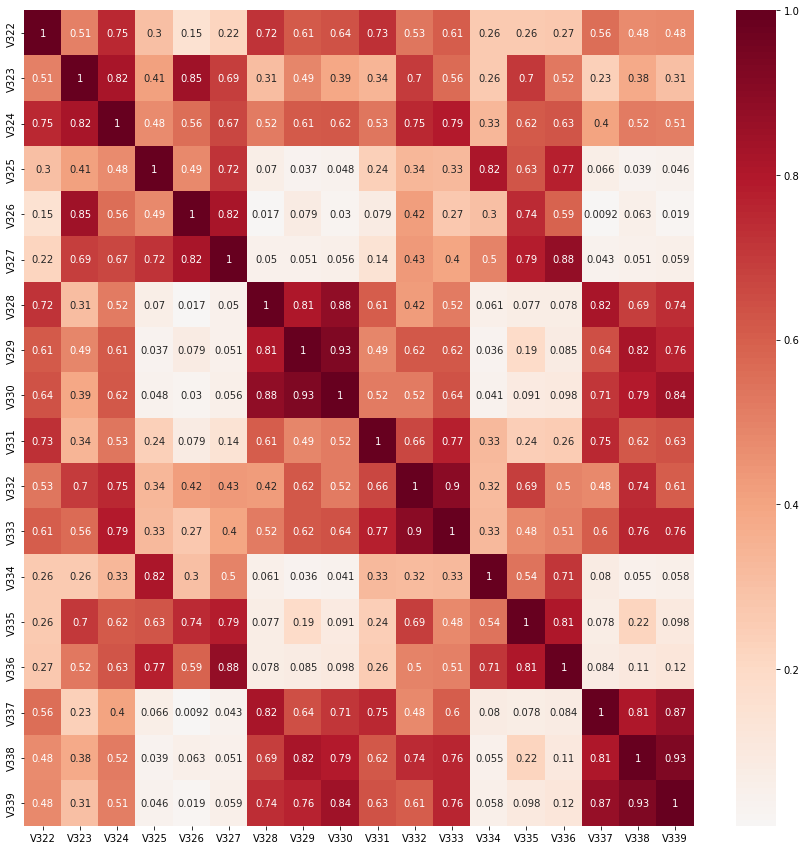

In [62]:
# correlation of group 11 v-columns within the group
ftgrp11_high_corr_pairs, ftgrp11_correlationMatrix, ftgrp11_todrop = plotCorrMatrixAndGetColsToDrop(isfraudt_df,(15,15),corrThresh,isfraudt_v_group_dict['ftgrp11'])


In [63]:
# extract the results from ftgrp11

ftgrp11_retain_cols = list(set(isfraudt_v_group_dict['ftgrp11']) - set(ftgrp11_todrop))
ftv_grp11_dict_results = {'Columns':(isfraudt_v_group_dict['ftgrp11']),
               'num columns':len(isfraudt_v_group_dict['ftgrp11']),
               'Dropping Columns':ftgrp11_todrop,
               'Num Columns Dropped':len(ftgrp11_todrop),
               'Retain Columns':ftgrp11_retain_cols,
               'Num Columns Retained': len(ftgrp11_retain_cols)}
ftv_grp11_dict_results

{'Columns': ['V322',
  'V323',
  'V324',
  'V325',
  'V326',
  'V327',
  'V328',
  'V329',
  'V330',
  'V331',
  'V332',
  'V333',
  'V334',
  'V335',
  'V336',
  'V337',
  'V338',
  'V339'],
 'num columns': 18,
 'Dropping Columns': ['V324',
  'V326',
  'V327',
  'V328',
  'V329',
  'V330',
  'V331',
  'V332',
  'V333',
  'V334',
  'V335',
  'V336',
  'V337',
  'V338',
  'V339'],
 'Num Columns Dropped': 15,
 'Retain Columns': ['V322', 'V323', 'V325'],
 'Num Columns Retained': 3}

#### **Summary of EDA of  Fraudulent V1-V339**

We subsetted the V-group columns of the fraudulent dataset and analysed the null structure of these columns.V-columns with similar null structures were grouped togather and further analysed to find any more granularity that could be utilized. We could not find any further deatils and conducted correlation analysis of subgroups of V-columns with similar null structure. We set the corerelation threshold to 0.65 and retained only the non-correlated features of each subgroup whose corelation was less than 0.65. 

As already found in the EDA of whole dataset and fraudulent dataset the major difference in null structure between the two subdatasets was the percentage of null values which were true for the V-columns too. Upon closer examination we found that althought the basic pattern of V-group columns being present as clusters exhibiting similar null values, the percentage of null values exhibited by V-columns among the two datasubsets varies. 

This difference could have implications in the columns that have been retained by this dataset that could vary from the columns that were retained in the complete dataset after the corerelation analysis. 

### Reduced V - Columns

In [77]:
# compare the retained list of train_transaction and isfraudt_df
# find the columns len of retained columns in each group
# find the columns from train_transaction that is not presentin isfraudt_df
# find columns from isfraudt_df that is not present in train_transaction

# Retain all columns from both

In [64]:
# Total reduced columns from the train_transaction dataframe

vt_reduced_col = v_grp1_dict_results['Retain Columns']+ v_grp2n4_dict_results['Retain Columns'] + v_grp3_dict_results['Retain Columns']+\
                v_grp5_dict_results['Retain Columns'] + v_grp6_dict_results['Retain Columns'] + v_grp7n11_dict_results['Retain Columns']+\
                v_grp8_dict_results['Retain Columns'] + v_grp9_dict_results['Retain Columns'] + v_grp10_dict_results['Retain Columns']
print(len(vt_reduced_col))
vt_reduced_col                

94


['V1',
 'V10',
 'V2',
 'V6',
 'V4',
 'V27',
 'V15',
 'V53',
 'V19',
 'V66',
 'V14',
 'V55',
 'V23',
 'V25',
 'V29',
 'V12',
 'V46',
 'V35',
 'V48',
 'V37',
 'V41',
 'V44',
 'V39',
 'V79',
 'V90',
 'V88',
 'V86',
 'V82',
 'V75',
 'V77',
 'V89',
 'V117',
 'V99',
 'V129',
 'V124',
 'V121',
 'V108',
 'V123',
 'V95',
 'V120',
 'V98',
 'V109',
 'V135',
 'V118',
 'V107',
 'V144',
 'V143',
 'V138',
 'V334',
 'V161',
 'V141',
 'V337',
 'V139',
 'V148',
 'V325',
 'V184',
 'V170',
 'V208',
 'V194',
 'V174',
 'V169',
 'V173',
 'V214',
 'V167',
 'V172',
 'V224',
 'V226',
 'V228',
 'V250',
 'V240',
 'V221',
 'V238',
 'V217',
 'V276',
 'V223',
 'V270',
 'V220',
 'V266',
 'V247',
 'V260',
 'V286',
 'V300',
 'V290',
 'V288',
 'V319',
 'V282',
 'V279',
 'V284',
 'V309',
 'V285',
 'V313',
 'V305',
 'V302',
 'V281']

In [65]:
# Total reduced columns from the sub-dataframe containng only fraud data

vfraud_reduced_col = ftv_grp1_dict_results['Retain Columns'] + ftv_grp2_dict_results['Retain Columns'] + ftv_grp3_dict_results['Retain Columns'] +\
                     ftv_grp4_dict_results['Retain Columns'] + ftv_grp5_dict_results['Retain Columns'] + ftv_grp6_dict_results['Retain Columns'] +\
                     ftv_grp7_dict_results['Retain Columns'] + ftv_grp8_dict_results['Retain Columns'] + ftv_grp9_dict_results['Retain Columns'] +\
                     ftv_grp10_dict_results['Retain Columns'] + ftv_grp11_dict_results['Retain Columns']
print(len(vfraud_reduced_col))
vfraud_reduced_col

90


['V1',
 'V10',
 'V2',
 'V6',
 'V4',
 'V28',
 'V27',
 'V15',
 'V19',
 'V14',
 'V23',
 'V25',
 'V29',
 'V12',
 'V46',
 'V35',
 'V48',
 'V37',
 'V41',
 'V39',
 'V57',
 'V61',
 'V53',
 'V69',
 'V66',
 'V55',
 'V65',
 'V68',
 'V79',
 'V90',
 'V88',
 'V82',
 'V80',
 'V75',
 'V77',
 'V89',
 'V105',
 'V117',
 'V108',
 'V126',
 'V95',
 'V104',
 'V120',
 'V98',
 'V96',
 'V107',
 'V139',
 'V143',
 'V138',
 'V141',
 'V194',
 'V180',
 'V174',
 'V191',
 'V169',
 'V173',
 'V167',
 'V209',
 'V181',
 'V172',
 'V224',
 'V226',
 'V227',
 'V240',
 'V217',
 'V223',
 'V270',
 'V220',
 'V234',
 'V241',
 'V247',
 'V260',
 'V261',
 'V286',
 'V300',
 'V297',
 'V296',
 'V288',
 'V279',
 'V284',
 'V285',
 'V306',
 'V310',
 'V313',
 'V305',
 'V302',
 'V281',
 'V322',
 'V323',
 'V325']

In [66]:
# Columns present in one group and not the other

# columns present in the reduced v-columns from the train_transaction df but not in fraud data
print(list(set(vt_reduced_col)-set(vfraud_reduced_col)))
print(len(list(set(vt_reduced_col)-set(vfraud_reduced_col))))

# columns present in the reduced v-columns from the fraud df but not in train_transaction df
print(list(set(vfraud_reduced_col)-set(vt_reduced_col)))
print(len(list(set(vfraud_reduced_col)-set(vt_reduced_col))))


['V184', 'V129', 'V290', 'V208', 'V250', 'V334', 'V44', 'V99', 'V121', 'V86', 'V228', 'V309', 'V238', 'V214', 'V276', 'V135', 'V148', 'V118', 'V282', 'V221', 'V123', 'V337', 'V319', 'V170', 'V124', 'V266', 'V161', 'V144', 'V109']
29
['V28', 'V322', 'V180', 'V69', 'V306', 'V104', 'V65', 'V261', 'V181', 'V68', 'V105', 'V297', 'V227', 'V126', 'V191', 'V323', 'V310', 'V234', 'V96', 'V209', 'V80', 'V61', 'V57', 'V296', 'V241']
25


In [67]:
# Total reduced columns to take and sorting it

temp = np.unique(vt_reduced_col + vfraud_reduced_col)
V_reduced = []
colNumbers = [int(i_col.split('V')[1]) for i_col in temp]
colNumbers.sort()
V_reduced = ['V' + str(i_col) for i_col in colNumbers]
print(len(V_reduced))
V_reduced

119


['V1',
 'V2',
 'V4',
 'V6',
 'V10',
 'V12',
 'V14',
 'V15',
 'V19',
 'V23',
 'V25',
 'V27',
 'V28',
 'V29',
 'V35',
 'V37',
 'V39',
 'V41',
 'V44',
 'V46',
 'V48',
 'V53',
 'V55',
 'V57',
 'V61',
 'V65',
 'V66',
 'V68',
 'V69',
 'V75',
 'V77',
 'V79',
 'V80',
 'V82',
 'V86',
 'V88',
 'V89',
 'V90',
 'V95',
 'V96',
 'V98',
 'V99',
 'V104',
 'V105',
 'V107',
 'V108',
 'V109',
 'V117',
 'V118',
 'V120',
 'V121',
 'V123',
 'V124',
 'V126',
 'V129',
 'V135',
 'V138',
 'V139',
 'V141',
 'V143',
 'V144',
 'V148',
 'V161',
 'V167',
 'V169',
 'V170',
 'V172',
 'V173',
 'V174',
 'V180',
 'V181',
 'V184',
 'V191',
 'V194',
 'V208',
 'V209',
 'V214',
 'V217',
 'V220',
 'V221',
 'V223',
 'V224',
 'V226',
 'V227',
 'V228',
 'V234',
 'V238',
 'V240',
 'V241',
 'V247',
 'V250',
 'V260',
 'V261',
 'V266',
 'V270',
 'V276',
 'V279',
 'V281',
 'V282',
 'V284',
 'V285',
 'V286',
 'V288',
 'V290',
 'V296',
 'V297',
 'V300',
 'V302',
 'V305',
 'V306',
 'V309',
 'V310',
 'V313',
 'V319',
 'V322',
 'V323',
 '

 **Summary of Reduced V-columns**

The V-columns that were retained from each subgroup of each dataset was concatanated to yeild the reduced V-list for that specific datataset. Hence we conctaeneated ttwo sets of subgroups of V-columns from the previous step giving us two V-reduced groups (consisting of reduced number of V-features that were selcted based on correlation (94 features for the whole daatset and 90 for the fraud dataset).

We then found the features from the reduced dataset that were unique to that group. We found about 29 features that were unique to the reduced group from the whole data and 25 unique to the reduced list from the fraud data.

We then took all the columns that were unique to the V-reduced group of both the datasets and all the columns that were present in the reduced group of both the datasets. This resulted in V-reduced features of about ~120 V-group features.




#### Analysis of reduced V-columns

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


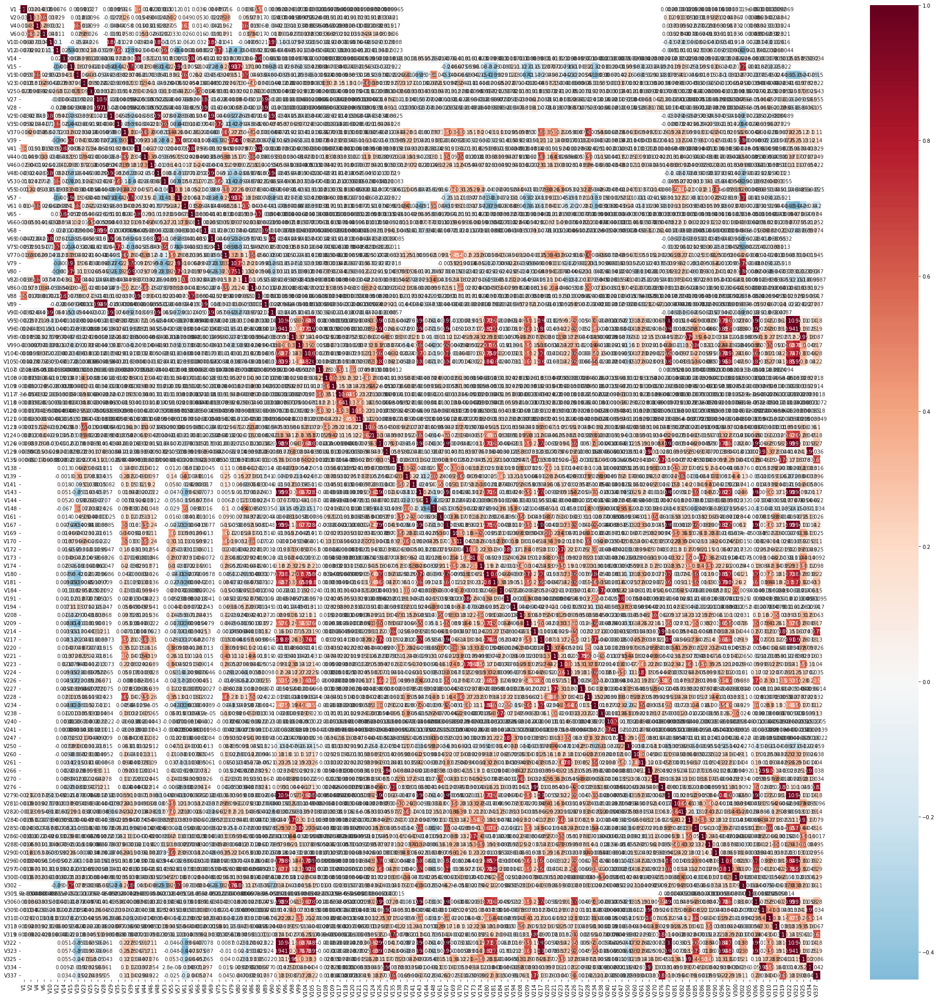

In [68]:
# Make SNS heat map and take out columns that are .9 and above. 
# Retain the column from the pair that is also present in the isfraudt_df list
corrThresh=.8
V_reduced_high_corr_pairs, V_reduced_correlationMatrix,V_reduced_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(35,35),corrThresh,V_reduced)

In [69]:
# extract the results from V_reduced columns

V_reduced_retain_cols = list(set(train_transaction[V_reduced]) - set(V_reduced_todrop))
V_reduced_dict_results = {'Columns':(train_transaction[V_reduced]),
               'num columns':len(train_transaction[V_reduced]),
               'Dropping Columns':V_reduced_todrop,
               'Num Columns Dropped':len(V_reduced_todrop),
               'Retain Columns':V_reduced_retain_cols,
               'Num Columns Retained': len(V_reduced_retain_cols)}
V_reduced_dict_results

{'Columns':          V1   V2   V4   V6  V10  V12  V14  V15  V19  V23  ...        V306  \
 0       1.0  1.0  1.0  1.0  0.0  1.0  1.0  0.0  1.0  1.0  ...    0.000000   
 1       NaN  NaN  NaN  NaN  NaN  0.0  1.0  0.0  1.0  1.0  ...    0.000000   
 2       1.0  1.0  1.0  1.0  0.0  1.0  1.0  0.0  1.0  1.0  ...    0.000000   
 3       NaN  NaN  NaN  NaN  NaN  1.0  1.0  0.0  1.0  1.0  ...   50.000000   
 4       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  ...    0.000000   
 ...     ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...         ...   
 590535  1.0  1.0  0.0  1.0  0.0  2.0  1.0  0.0  0.0  1.0  ...    0.000000   
 590536  1.0  1.0  1.0  1.0  0.0  1.0  1.0  0.0  1.0  1.0  ...    0.000000   
 590537  1.0  1.0  1.0  1.0  1.0  1.0  1.0  0.0  1.0  1.0  ...    0.000000   
 590538  1.0  1.0  2.0  1.0  0.0  1.0  1.0  0.0  2.0  1.0  ...  117.000000   
 590539  1.0  1.0  1.0  1.0  1.0  2.0  1.0  0.0  1.0  2.0  ...  279.950012   
 
          V309        V310        V313        V319 

### EDA of C-Columns

In [70]:
# Creating a dictionary of the groups of V-columns to create subplots of the groups to visualize null values
# Grouping the V-columns based on their percentage of null values

corrThresh = 0.65
c_group_dict = {'ctgrp':['C' + str(i) for i in range(1,15)]}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


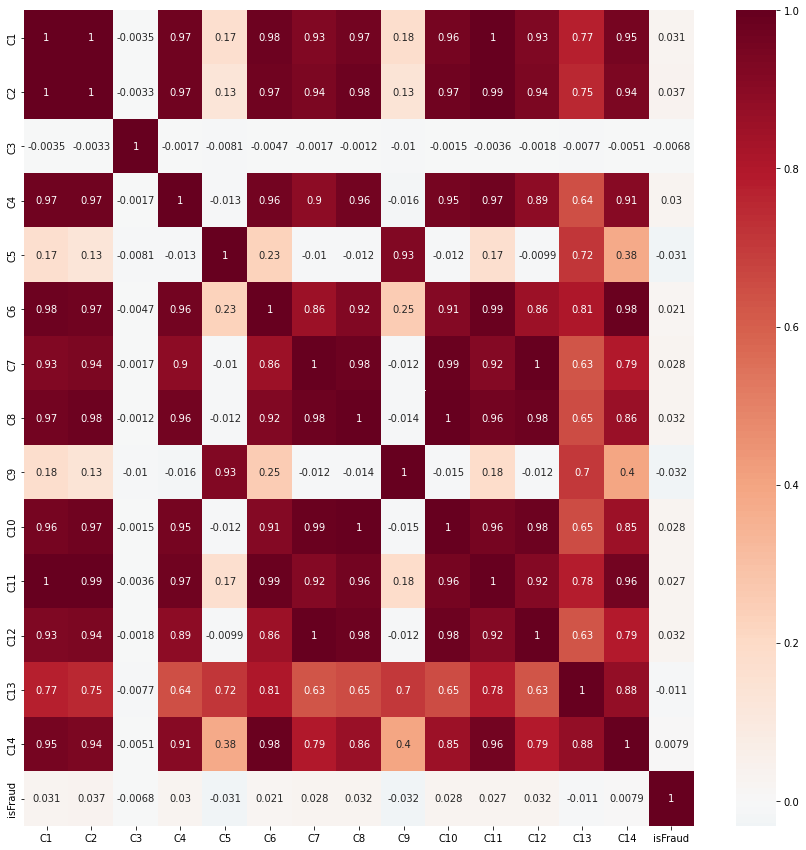

In [71]:
# Correlation of C-grp columns with the target variable and within V columns
ctgrp_high_corr_pairs, ctgrp_correlationMatrix, ctgrp_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(15,15),corrThresh,c_group_dict['ctgrp']+['isFraud'])

In [72]:
# extract the results from C grp columns

c_retain_cols = list(set(c_group_dict['ctgrp']) - set(ctgrp_todrop))
c_group_dict_results = {'Columns':c_group_dict['ctgrp'],
               'num columns':len(c_group_dict['ctgrp']),
               'Dropping Columns':ctgrp_todrop,
               'Num Columns Dropped':len(ctgrp_todrop),
               'Retain Columns':c_retain_cols,
               'Num Columns Retained': len(c_retain_cols)}
c_group_dict_results

{'Columns': ['C1',
  'C2',
  'C3',
  'C4',
  'C5',
  'C6',
  'C7',
  'C8',
  'C9',
  'C10',
  'C11',
  'C12',
  'C13',
  'C14'],
 'num columns': 14,
 'Dropping Columns': ['C2',
  'C4',
  'C6',
  'C7',
  'C8',
  'C9',
  'C10',
  'C11',
  'C12',
  'C13',
  'C14'],
 'Num Columns Dropped': 11,
 'Retain Columns': ['C3', 'C1', 'C5'],
 'Num Columns Retained': 3}

In [87]:
# look at c-9  not selected eventhough it is not much corelated

#### Summary of EDA of C-columns

We performed corelation analysis and set the threshold to 0.65 and retained columns that were not corerelated and whose corerelation coefficients were less than 0.65. 

We found that we could reatin only 3 column out of the 14 features that contained 11 hughly corerelatedd features. 

### EDA of D-Columns

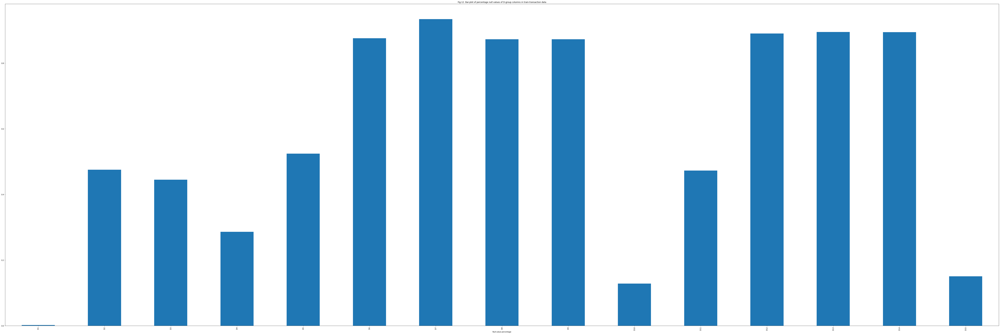

In [73]:
# Bar chart of the V-columns based on the null values

dCol_null_columns_prcnt = train_transaction.isna().sum()/train_transaction.shape[0]
dCol_colsToPlot = ['D' + str(i) for i in range(1,16)]
plt.figure(figsize=(105,35))
dCol_null_columns_prcnt[dCol_colsToPlot].plot(kind='bar')
plt.title("Fig-12: Bar-plot of percentage null values of D-group columns in train-transaction data")
plt.xlabel('Null-value percentage')
plt.show()

In [74]:
# Creating a dictionary of the groups of V-columns to create subplots of the groups to visualize null values
# Grouping the V-columns based on their percentage of null values

corrThresh = 0.65
d_group_dict = {'dtgrp':['D' + str(i) for i in range(1,16)]}

<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


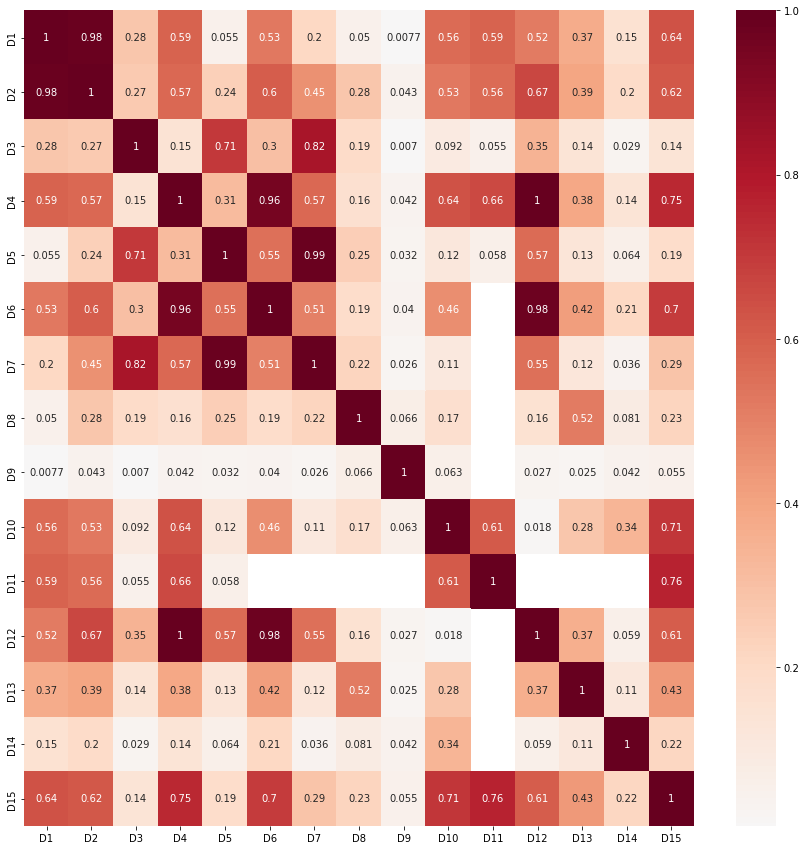

In [75]:
# Correlation of grp-1 with the target variable and within V columns
corrThresh = 0.65
dtgrp1_high_corr_pairs, dtgrp1_correlationMatrix, dtgrp1_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction,(15,15),corrThresh,d_group_dict['dtgrp'])

In [76]:
# extract the results from D grp columns

d_retain_cols = list(set(d_group_dict['dtgrp']) - set(dtgrp1_todrop))
d_group_dict_results = {'Columns':d_group_dict['dtgrp'],
               'num columns':len(d_group_dict['dtgrp']),
               'Dropping Columns':dtgrp1_todrop,
               'Num Columns Dropped':len(dtgrp1_todrop),
               'Retain Columns':d_retain_cols,
               'Num Columns Retained': len(d_retain_cols)}
d_group_dict_results

{'Columns': ['D1',
  'D2',
  'D3',
  'D4',
  'D5',
  'D6',
  'D7',
  'D8',
  'D9',
  'D10',
  'D11',
  'D12',
  'D13',
  'D14',
  'D15'],
 'num columns': 15,
 'Dropping Columns': ['D2', 'D5', 'D6', 'D7', 'D11', 'D12', 'D15'],
 'Num Columns Dropped': 7,
 'Retain Columns': ['D13', 'D1', 'D3', 'D10', 'D4', 'D9', 'D14', 'D8'],
 'Num Columns Retained': 8}

#### Summary of EDA of D-columns

After performing correlation analysis with the D-group columns we found that out of the 15 features present, 7 features were highly corerelated and hence we could retain only the remaining 8 features whose coefficients of corerelation was less than 0.65.

### EDA of M-Columns

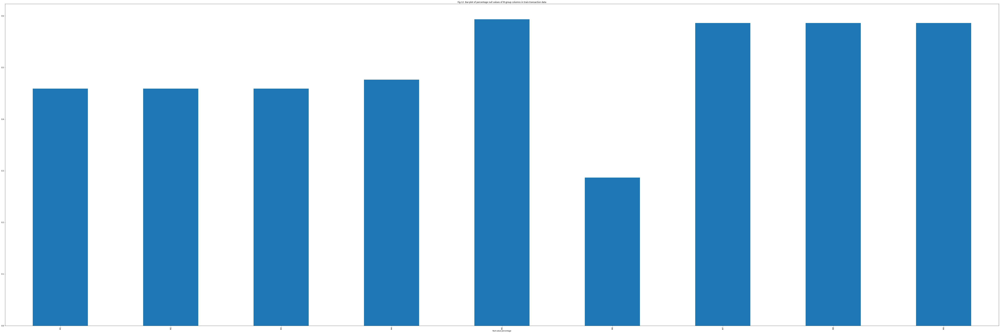

In [77]:
# Bar chart of the V-columns based on the null values

mCol_null_columns_prcnt = train_transaction.isna().sum()/train_transaction.shape[0]
mCol_colsToPlot = ['M' + str(i) for i in range(1,10)]
plt.figure(figsize=(105,35))
mCol_null_columns_prcnt[mCol_colsToPlot].plot(kind='bar')
plt.title("Fig-12: Bar-plot of percentage null values of M-group columns in train-transaction data")
plt.xlabel('Null-value percentage')
plt.show()

In [78]:
# Creating a dictionary of the groups of M-columns to create subplots of the groups to visualize null values
# Grouping the M-columns based on their percentage of null values

corrThresh = 0.60
m_group_dict = {'mtgrp':['M' + str(i) for i in range(1,10)]}


In [79]:
# Label encoding the M-group columns

mp = {'F':0,'T':1,'M0':0,'M1':1,'M2':2}
for c in m_group_dict['mtgrp']: 
  train_transaction[c] = train_transaction[c].map(mp)
train_transaction[m_group_dict['mtgrp']]

,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,1.0,1.0,1.0,2.0,0.0,1.0,NaN,NaN,NaN
1,NaN,NaN,NaN,0.0,1.0,1.0,NaN,NaN,NaN
2,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
3,NaN,NaN,NaN,0.0,1.0,0.0,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
590535,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
590536,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
590537,1.0,0.0,0.0,NaN,NaN,1.0,NaN,NaN,NaN
590538,1.0,1.0,1.0,0.0,0.0,1.0,NaN,NaN,NaN


<ipython-input-21-d583c93e6e4c>:24: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  upper = grp_correlationMatrix.where(np.triu(np.ones(grp_correlationMatrix.shape), k=1).astype(np.bool))


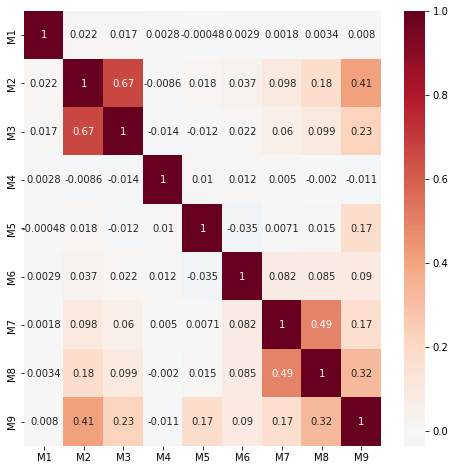

In [80]:
# Correlation of grp-M with the target variable and within V columns
corrThresh = 0.65
mtgrp1_high_corr_pairs, mtgrp1_correlationMatrix, mtgrp1_todrop = plotCorrMatrixAndGetColsToDrop(train_transaction, (8,8), corrThresh, m_group_dict['mtgrp'])

In [81]:
# extract the results from M grp columns

m_retain_cols = list(set(m_group_dict['mtgrp']) - set(mtgrp1_todrop))
m_group_dict_results = {'Columns':m_group_dict['mtgrp'],
               'num columns':len(m_group_dict['mtgrp']),
               'Dropping Columns':mtgrp1_todrop,
               'Num Columns Dropped':len(mtgrp1_todrop),
               'Retain Columns':m_retain_cols,
               'Num Columns Retained': len(m_retain_cols)}
m_group_dict_results

{'Columns': ['M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9'],
 'num columns': 9,
 'Dropping Columns': ['M3'],
 'Num Columns Dropped': 1,
 'Retain Columns': ['M7', 'M5', 'M1', 'M9', 'M2', 'M6', 'M8', 'M4'],
 'Num Columns Retained': 8}

#### Summary of EDA of M columns

The M-group contained several categorical column that were label encoded before performing the corerelation analysis. The results of the corerelation analysis yeided 8 columns that were uncorerelated out of the 9 columns present. This groups contained relativeley very less corerelated features and hence we could reatin almost all the features of this group except one. 

## SELECTED FEATURES FROM THE TRAIN_TRANSACTION DATAFRAME

In [82]:
# Selecting and grouping all the retained features from the V, C, D and M columns

features_to_retain = {'columns_to_retain':V_reduced_dict_results['Retain Columns']+c_group_dict_results['Retain Columns']+\
                      d_group_dict_results['Retain Columns'] + m_group_dict_results['Retain Columns']+\
                      ['TransactionID','isFraud',	'TransactionDT',	'TransactionAmt',	'ProductCD',\
                       'card1',	'card2',	'card3',	'card4',	'card5',	'card6',	'addr1',	'addr2',\
                       'dist1',	'dist2',	'P_emaildomain',	'R_emaildomain'	] }
pd.DataFrame(features_to_retain).to_csv('columns_to_retain.csv')

In [85]:
len(features_to_retain['columns_to_retain'])

114

In [83]:
# copy and save the columns in the results i.e classification_products directory

!cp 'columns_to_retain.csv' '/content/drive/MyDrive/PCMALAI_UCBerkeley_Capstone/Classification_products/columns_to_retain.csv'

Here, we concatanate the features from all the groups, namely, V-reduced (the group contains all the features from fraud and complete dataset), C, D and M groups of data along with other non-grouped features. 

The total number of features this obtained after a sequential analaysis during our EDA is. columns and.  rows. 

These are saved as a .csv file for modelbuilding in the future steps of the task of building a classification model that can correctly predict a fraudulent transaction. 